### imports


In [2]:
from SEAM.utils import *
import SEAM
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import cv2
from sklearn.decomposition import PCA
import re
from scipy.spatial.distance import *


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
Using TensorFlow backend.


### settings


In [3]:
sns.set_style("white")
# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 2}

# matplotlib.rc('font', **font)
# matplotlib.rcParams.update({'font.size': 2})

import matplotlib.pyplot as plt

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc("font", size=SMALL_SIZE)  # controls default text sizes
plt.rc("axes", titlesize=SMALL_SIZE)  # fontsize of the axes title
plt.rc("axes", labelsize=MEDIUM_SIZE)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SMALL_SIZE)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SMALL_SIZE)  # fontsize of the tick labels
plt.rc("legend", fontsize=SMALL_SIZE)  # legend fontsize
plt.rc("figure", titlesize=BIGGER_SIZE)  # fontsize of the figure title



### functions


In [157]:
import imageio
from scipy import ndimage as ndi


def load_segment(sample, mode):
    base_path = "/home/yzy/bioSIMS/data/Segment_{0}/".format(mode)
    im = imageio.imread(base_path + "{0}.png".format(sample))
    #     print(im.shape)
    im_bool = im[:, :, 0].copy()
    im_bool[im_bool > 0] = 1
    im_bool = im_bool.astype("int64")
    im_int, _ = ndi.label(im_bool)
    return im_bool, im, im_int



### get Cut mask


In [73]:
name_dict = {
    "20190103_intestine1_filter": "Intestine",
    "mouse0_kidney0_neg0_high0_20_None_auto": "Kidney",
    "mouse0_liver0_neg1_high0_div15_None_ada": "Liver_1",
    "mouse1_liver0_neg0_high0_None_ada": "Liver_4",
    "mouse1_liver0_neg1_high0_None_ada": "Liver_5",
    "mouse1_liver0_neg2_high0_None_ada": "Liver_6",
    "P1": "R6",
    "P2_None_ada": "R7",
    "P3_R3_None_auto": "R8",
    "P3_R4_None_ada": "R9",
    "P3_R5_None_ada": "R10",
    "P5LC_NEG1_HIGH0_None_auto": "R5",
    "P6_neg0_low0_None_auto": "R2",
    "P6_neg1_low0_None_auto": "R1",
    "P6_neg2_low0_None_auto": "R4",
    "P6_neg3_low0_None_auto": "R3",
}


In [74]:
sample_mask_dict = {}


Processing 20190103_intestine1_filter...
check success!
setting obsm: spatial
Processing mouse0_kidney0_neg0_high0_20_None_auto...
check success!
setting obsm: spatial
Processing mouse0_liver0_neg1_high0_div15_None_ada...
check success!
setting obsm: spatial
Processing mouse1_liver0_neg0_high0_None_ada...
check success!
setting obsm: spatial
Processing mouse1_liver0_neg1_high0_None_ada...
check success!
setting obsm: spatial
Processing mouse1_liver0_neg2_high0_None_ada...
check success!
setting obsm: spatial
Processing P1...
check success!
setting obsm: spatial
Processing P2_None_ada...
check success!
setting obsm: spatial
Processing P3_R3_None_auto...
check success!
setting obsm: spatial
Processing P3_R4_None_ada...
check success!
setting obsm: spatial
Processing P3_R5_None_ada...
check success!
setting obsm: spatial
Processing P5LC_NEG1_HIGH0_None_auto...
check success!
setting obsm: spatial
Processing P6_neg0_low0_None_auto...
check success!
setting obsm: spatial
Processing P6_neg1_

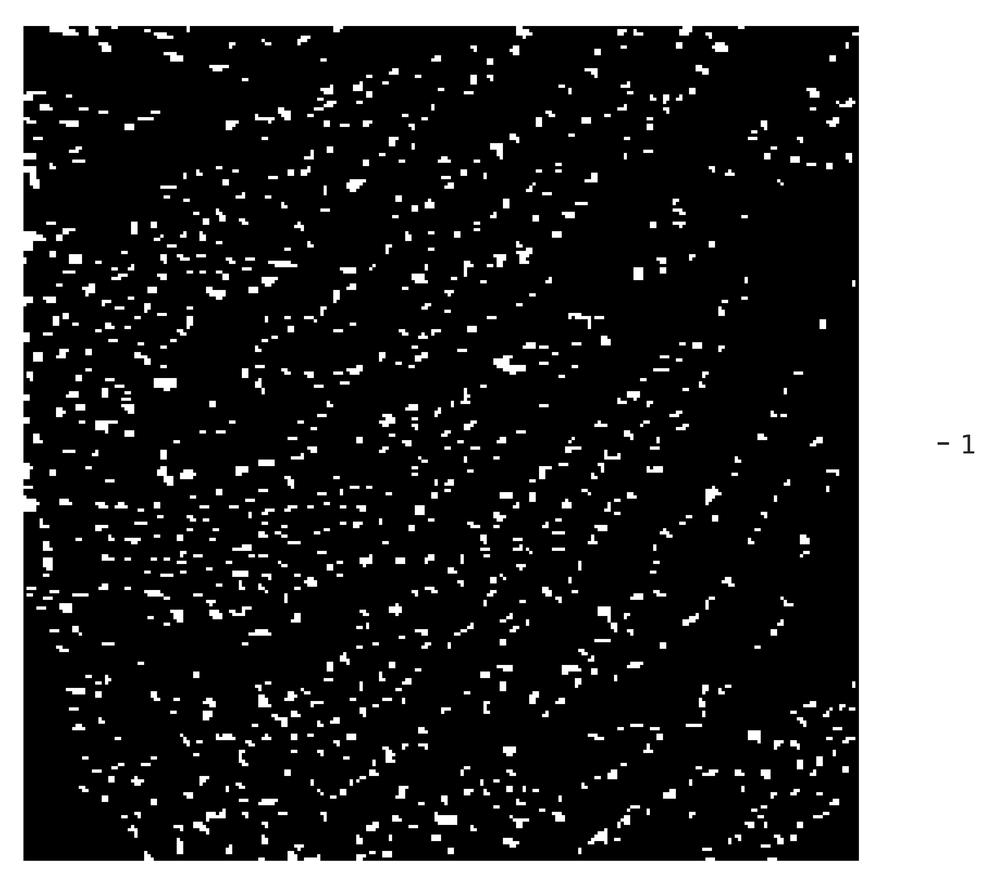

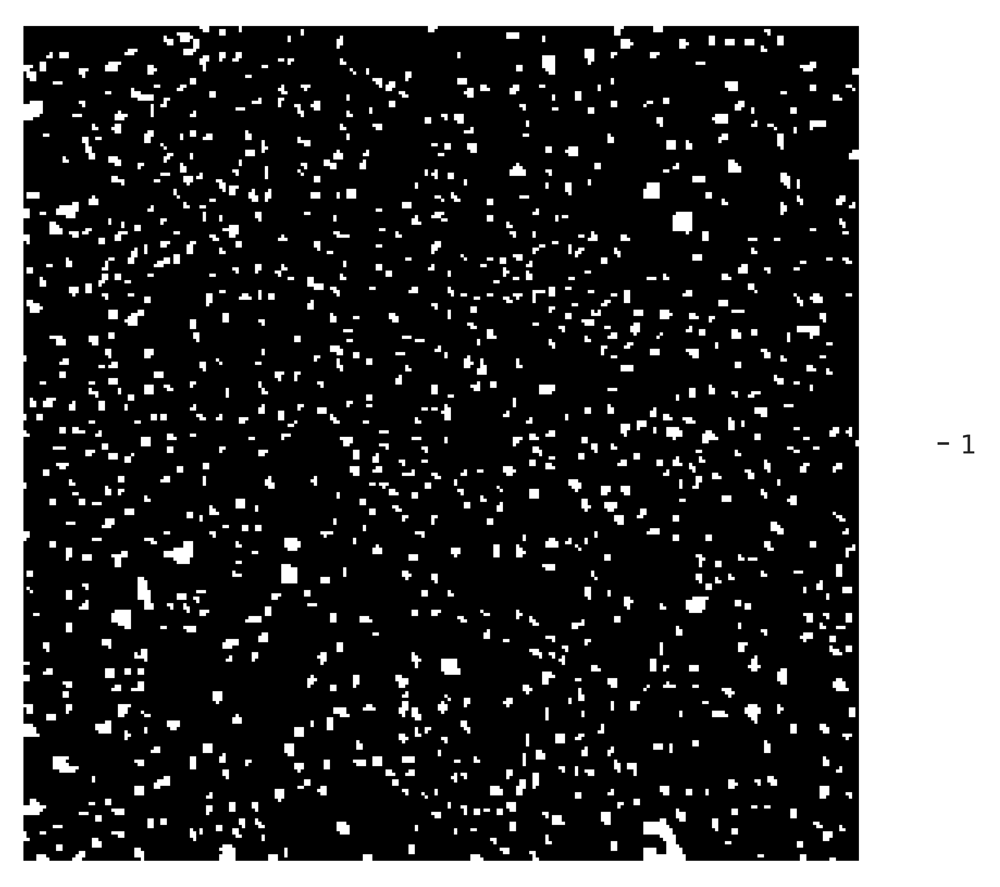

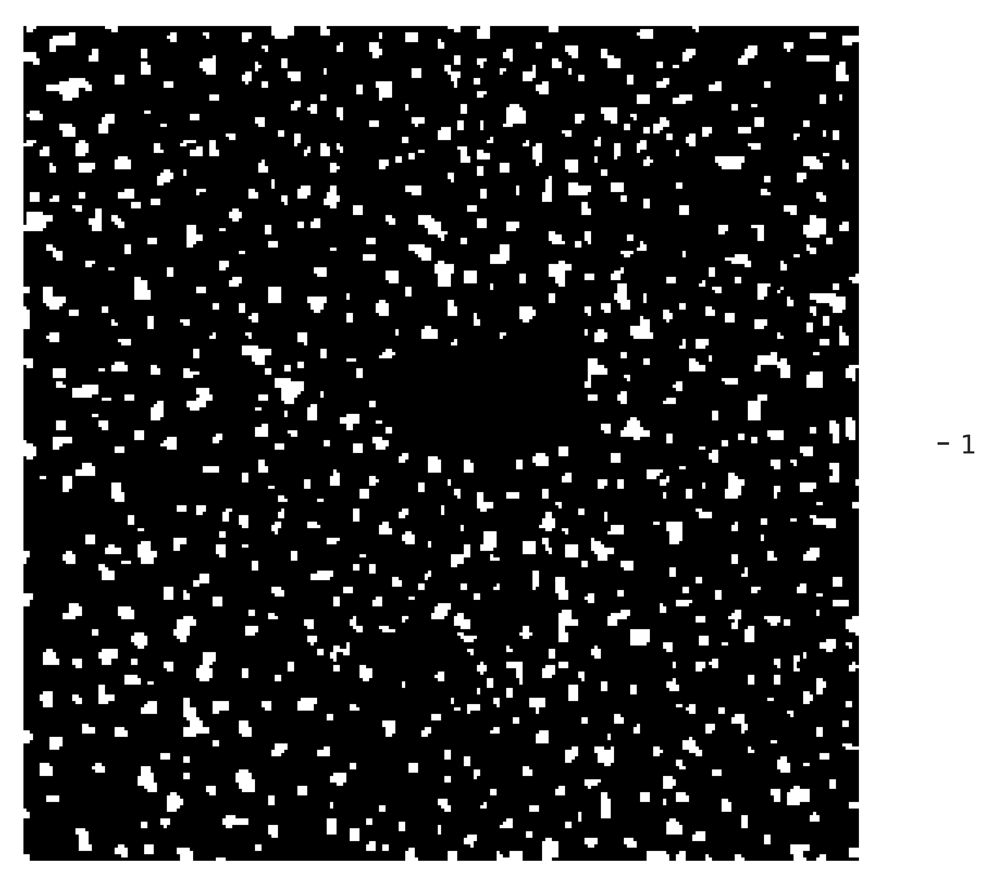

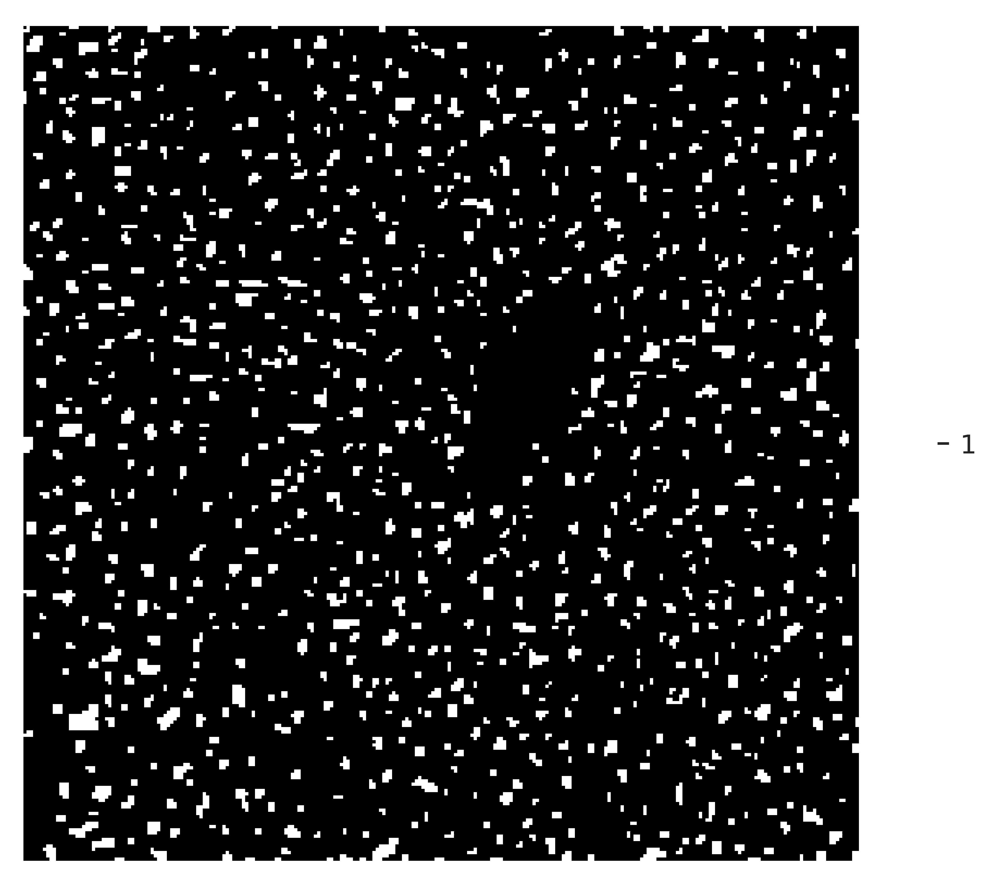

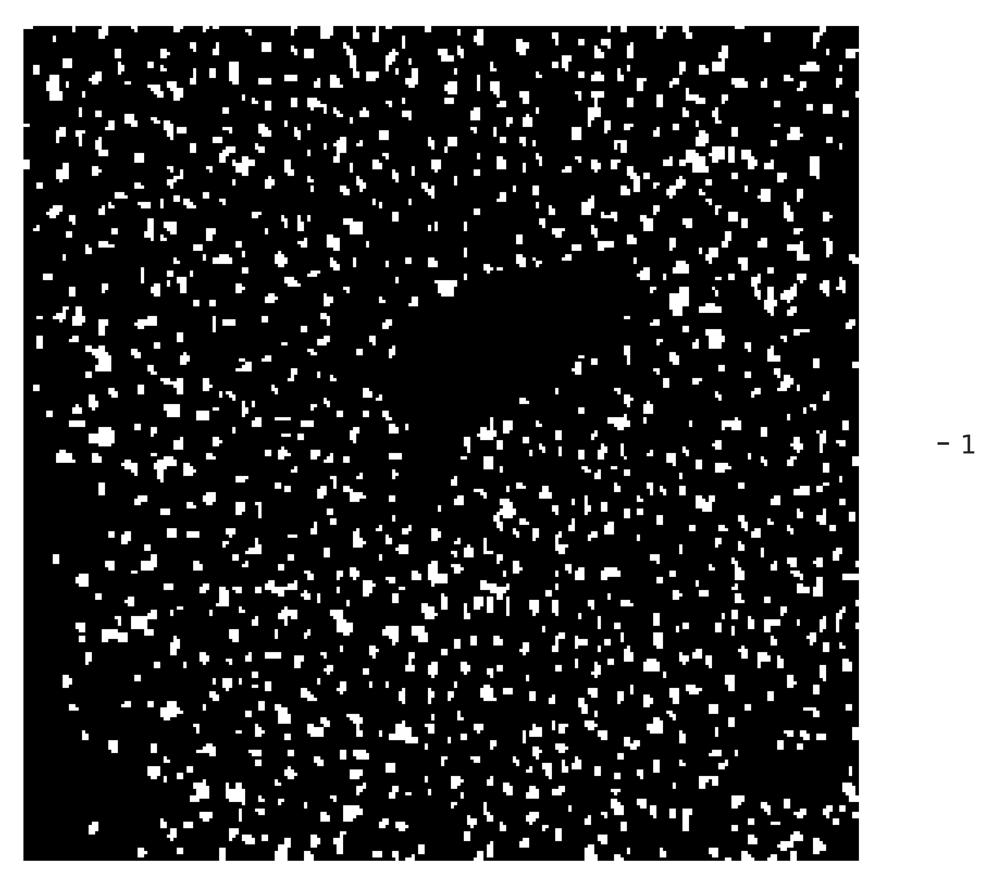

...

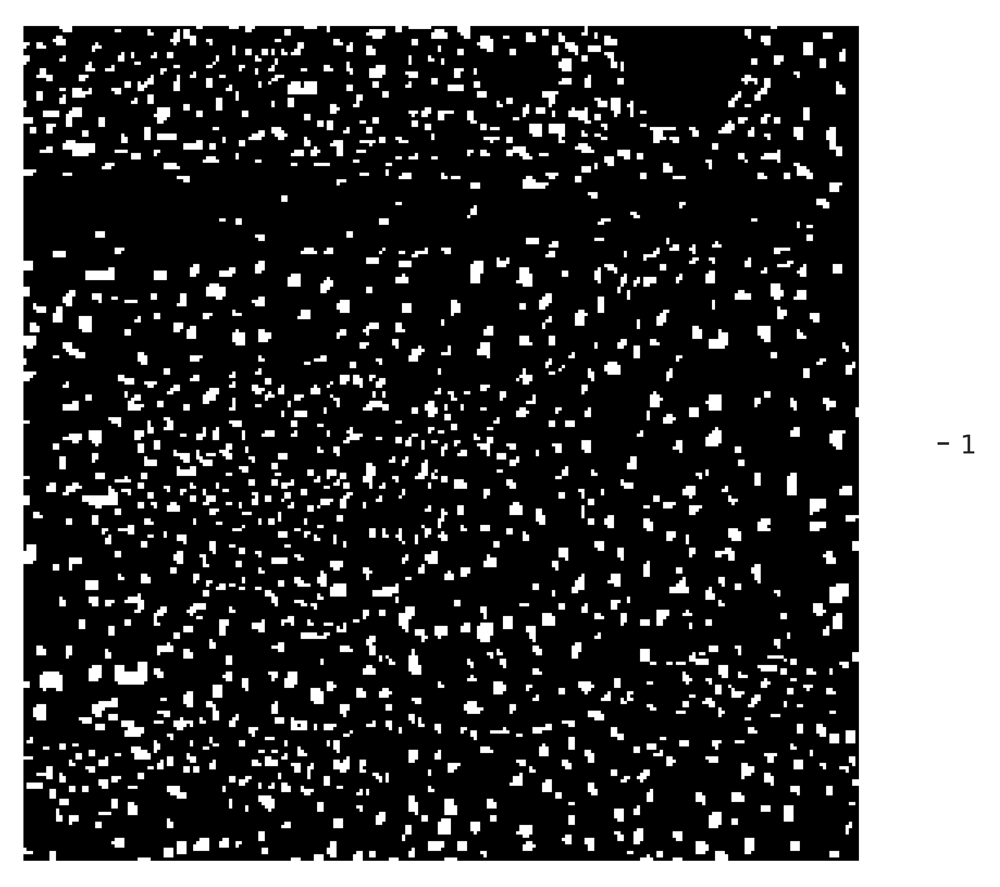

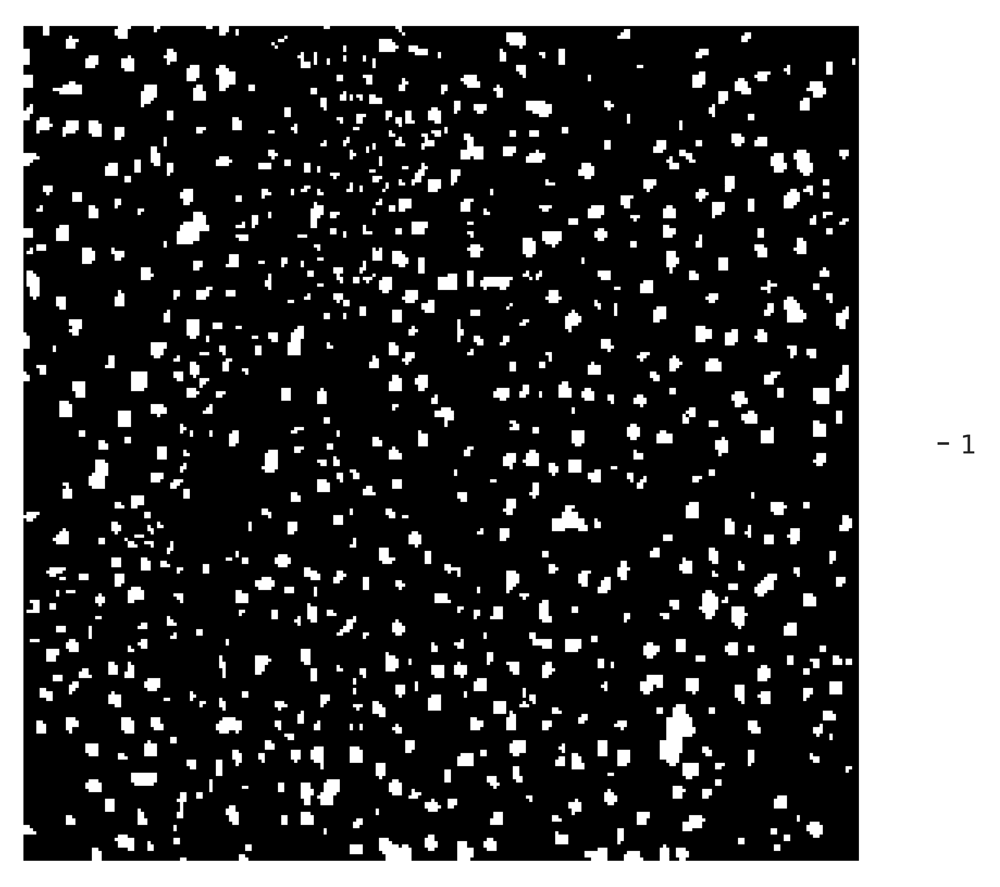

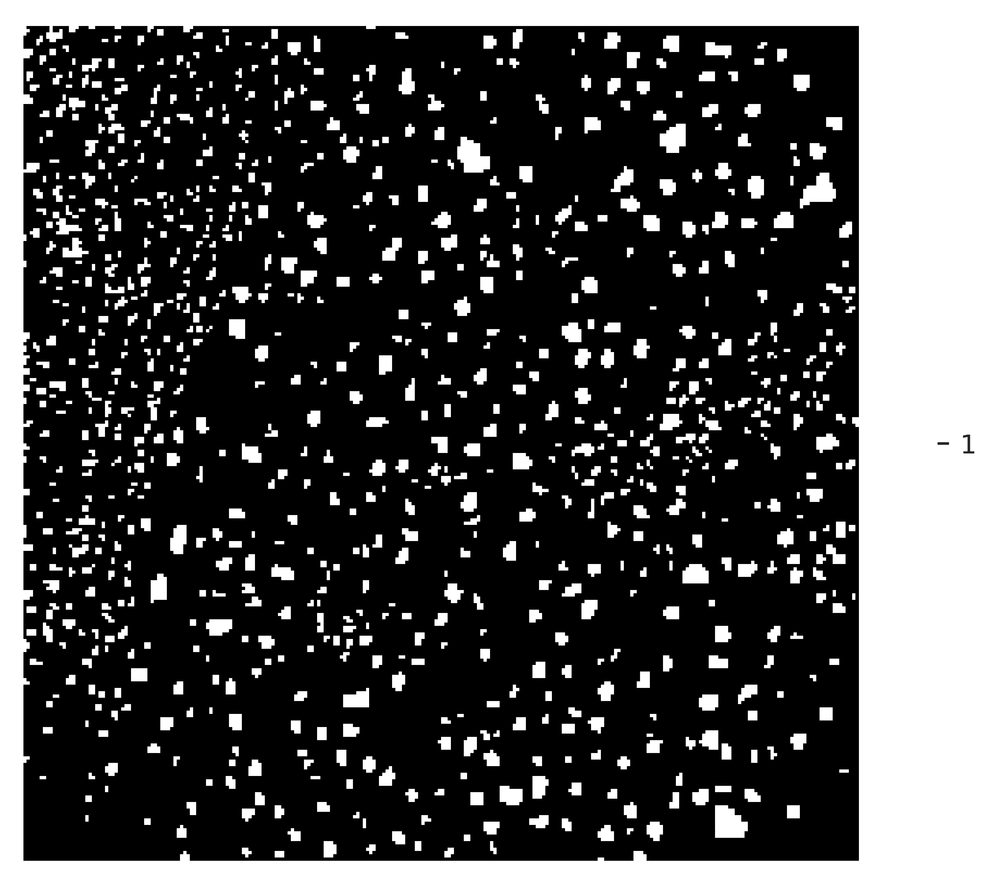

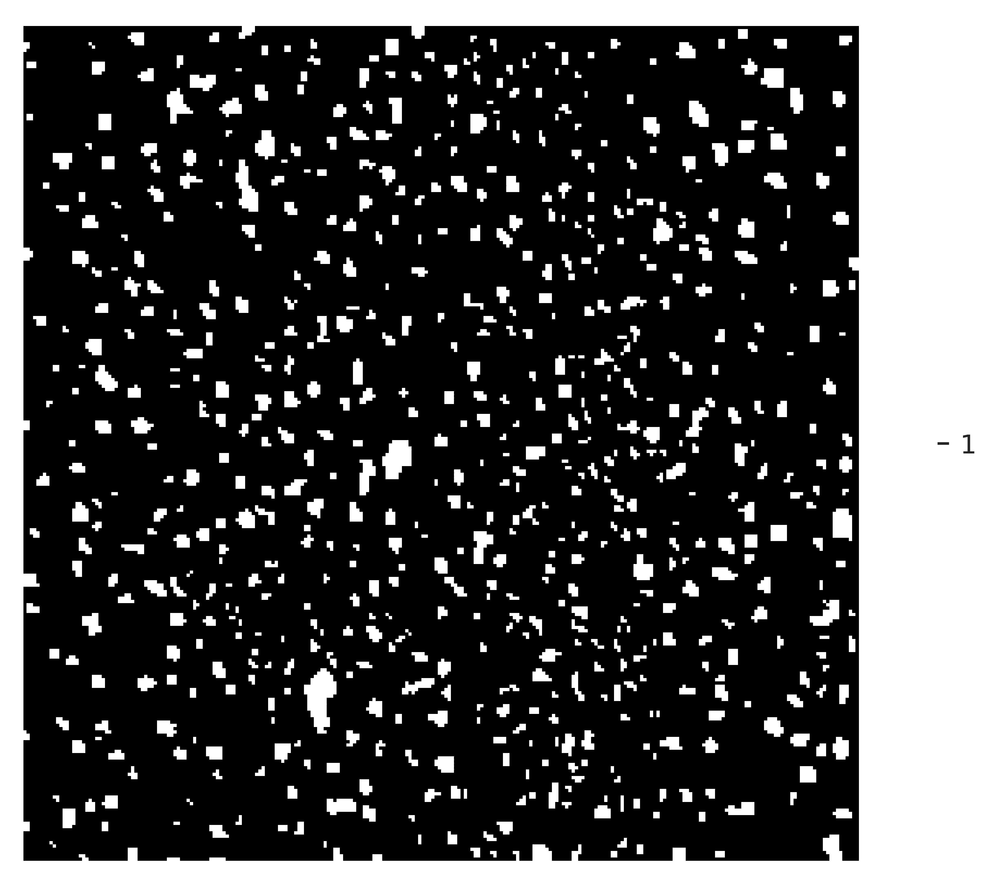

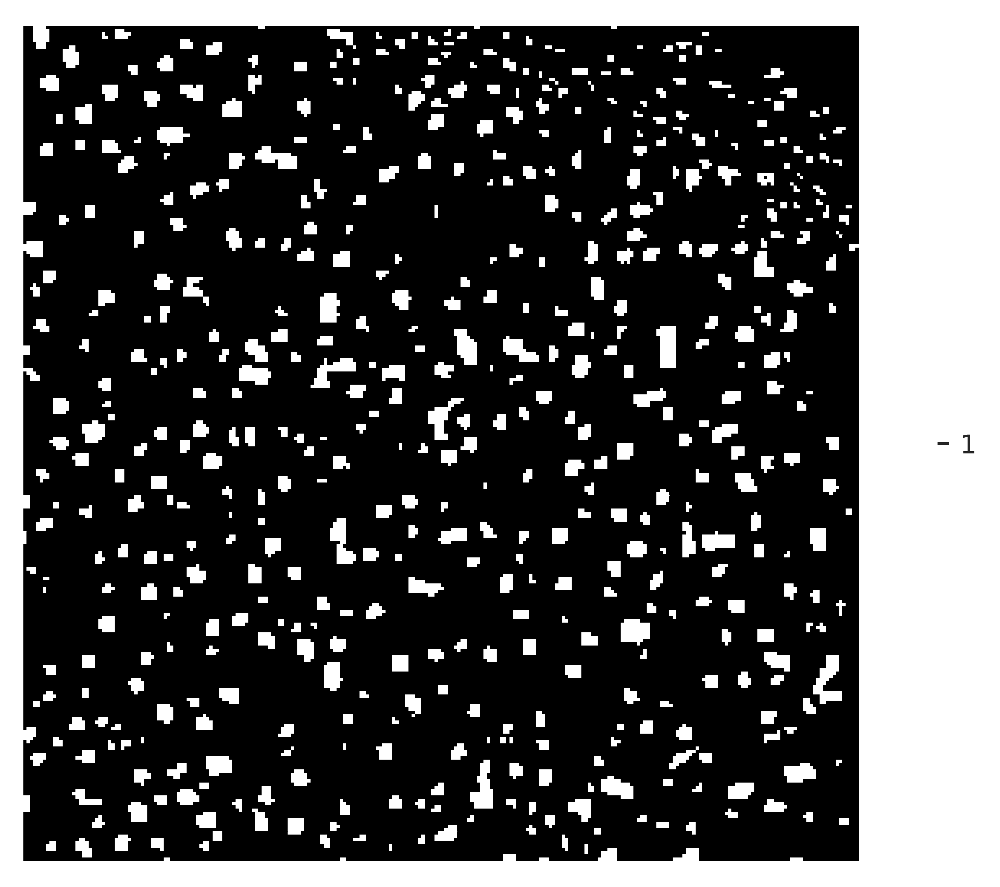

In [75]:
# test_path_list = [
#     'mcf7_high',
#     'P3_R6_None_ada'
# ]
base_path = "/home/yzy/bioSIMS/data/process/"
cut_save_path = "/home/yzy/bioSIMS/data/Segment_Cut/"
for data_name in name_dict.keys():
    # for data_name in test_path_list:

    print("Processing {0}...".format(data_name))
    cur_path = base_path + data_name + "/"

    if not (os.path.exists(cur_path + "cut/") and os.path.exists(cur_path + "preprocess/")):
        print("Cut or preprocess subfolder not found!")
        continue
    preprocess_path = cur_path + "preprocess/"
    if "test_samples.mat" not in os.listdir(preprocess_path):
        for file_in_preprocess in os.listdir(preprocess_path):
            if "test_samples" in file_in_preprocess:
                test_samples_num = re.findall("\d+", file_in_preprocess)[0]
                if int(test_samples_num) > 100:
                    tmp = shutil.copy2(preprocess_path + file_in_preprocess, preprocess_path + "test_samples.mat")
    cut_path = cur_path + "cut/rst/"
    if "datamat.mat" not in os.listdir(cut_path):
        for file_in_cut in os.listdir(cut_path):
            #             datamat_num_list = []
            #             if 'datamat' in file_in_cut:
            #                 datamat_num = re.findall('\d.\d',file_in_cut)[0]
            #                 datamat_num_list.append(float(datamat_num))
            #         tmp = shutil.copy2(cut_path+'datamat_{0}.mat'.format(np.max(datamat_num_list)),cut_path+'datamat.mat')
            if "datamat" in file_in_cut:
                tmp = shutil.copy2(cut_path + file_in_cut, cut_path + "datamat.mat")

    #     final check
    if not (
        os.path.exists(preprocess_path + "test_samples.mat")
        and os.path.exists(cut_path + "datamat.mat")
        and os.path.exists(preprocess_path + "matters_candidate.pkl")
    ):
        print("check failed")
        continue
    print("check success!")
    a = SEAM.datasets.load_dataset_raw(data_name)
    if a.uns["IMS"].shape[0] != 65536:
        print("size not match 65536")
        del a
        continue
    SEAM.tl.Cut(a)
    SEAM.pl.Cut(a, method="mask", save=cut_save_path + name_dict[data_name] + ".png", ifshow=False)
    #     del a
    mask_flatten = np.zeros(shape=(65536,))
    mask_flatten[a.uns["cell_pos"] - 1] = 1
    mask = mask_flatten.reshape(256, 256)
    sample_mask_dict[name_dict[data_name]] = mask
    del a


In [104]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


### get adenine image


In [19]:
name_dict_get_adenine = {
    "20190103_intestine1_filter": "Intestine",
    "mouse0_kidney0_neg0_high0_20_None_auto": "Kidney",
    "mouse0_liver0_neg1_high0_div15_None_ada": "Liver_1",
    "mouse1_liver0_neg0_high0_None_ada": "Liver_4",
    "mouse1_liver0_neg1_high0_None_ada": "Liver_5",
    "mouse1_liver0_neg2_high0_None_ada": "Liver_6",
    "P1": "R6",
    "P2_None_ada": "R7",
    "P3_R3_None_auto": "R8",
    "P3_R4_None_ada": "R9",
    "P3_R5_None_ada": "R10",
    "P5LC_NEG1_HIGH0_None_auto": "R5",
    "P6_neg0_low0_None_auto": "R2",
    "P6_neg1_low0_None_auto": "R1",
    "P6_neg2_low0_None_auto": "R4",
    "P6_neg3_low0_None_auto": "R3",
    "cl_sk_None": "SK",
    "cl_10a_None": "10A",
    "cl_a549_None": "A549",
    "cl_hela_None": "Hela",
    "mcf7_high": "MCF7",
    "lung_cut_gaussian": "Lung",
    "mouse0_liver0_neg2_high0_None_ada": "Liver_2",
    "mouse0_liver0_neg0_high0_div5_None": "Liver_3",
}
len(name_dict_get_adenine)


24

In [20]:
# test_path_list = [
#     'mcf7_high',
#     'P3_R6_None_ada'
# ]
base_path = "/home/yzy/bioSIMS/data/process/"
cut_save_path = "/home/yzy/bioSIMS/data/Segment_Cut/"
tissue_adenine_dict = {}
for data_name in name_dict_get_adenine.keys():
    # for data_name in test_path_list:

    print("Processing {0}...".format(data_name))
    cur_path = base_path + data_name + "/"

    if not (os.path.exists(cur_path + "preprocess/")):
        print("Cut or preprocess subfolder not found!")
        continue
    preprocess_path = cur_path + "preprocess/"

    for file_in_preprocess in os.listdir(preprocess_path):
        if "test_samples" in file_in_preprocess:
            if len(re.findall("\d+", file_in_preprocess)) == 0:
                continue
            test_samples_num = re.findall("\d+", file_in_preprocess)[0]

            if int(test_samples_num) < 100:
                #                 tmp = shutil.copy2(preprocess_path+file_in_preprocess,preprocess_path+'test_samples.mat')
                cur_adenine = sio.loadmat(preprocess_path + file_in_preprocess)["test_samples"]
                tissue_adenine_dict[name_dict_get_adenine[data_name]] = cur_adenine[:, 0].reshape(256, 256)
#                 print(cur_adenine.shape)
#                 plt.imshow(cur_adenine[:,0].reshape(256,256))
#                 plt.show()


Processing 20190103_intestine1_filter...
Processing mouse0_kidney0_neg0_high0_20_None_auto...
Processing mouse0_liver0_neg1_high0_div15_None_ada...
Processing mouse1_liver0_neg0_high0_None_ada...
Processing mouse1_liver0_neg1_high0_None_ada...
Processing mouse1_liver0_neg2_high0_None_ada...
Processing P1...
Processing P2_None_ada...
Processing P3_R3_None_auto...
Processing P3_R4_None_ada...
Processing P3_R5_None_ada...
Processing P5LC_NEG1_HIGH0_None_auto...
Processing P6_neg0_low0_None_auto...
Processing P6_neg1_low0_None_auto...
Processing P6_neg2_low0_None_auto...
Processing P6_neg3_low0_None_auto...
Processing cl_sk_None...
Processing cl_10a_None...
Processing cl_a549_None...
Processing cl_hela_None...
Processing mcf7_high...
Processing lung_cut_gaussian...
Processing mouse0_liver0_neg2_high0_None_ada...
Processing mouse0_liver0_neg0_high0_div5_None...


### others


### compare Cut256 and SIMS (SK)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [223]:
tissue = "SK"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


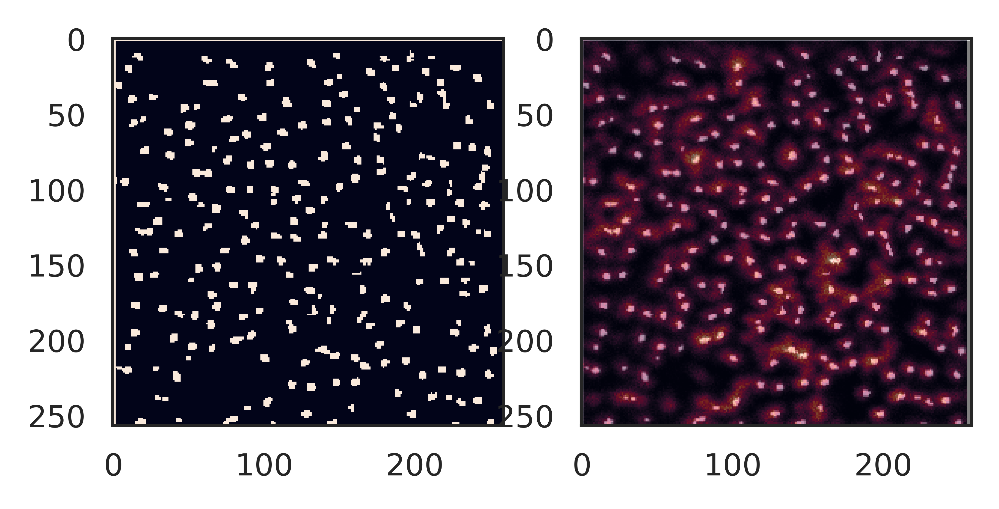

In [224]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


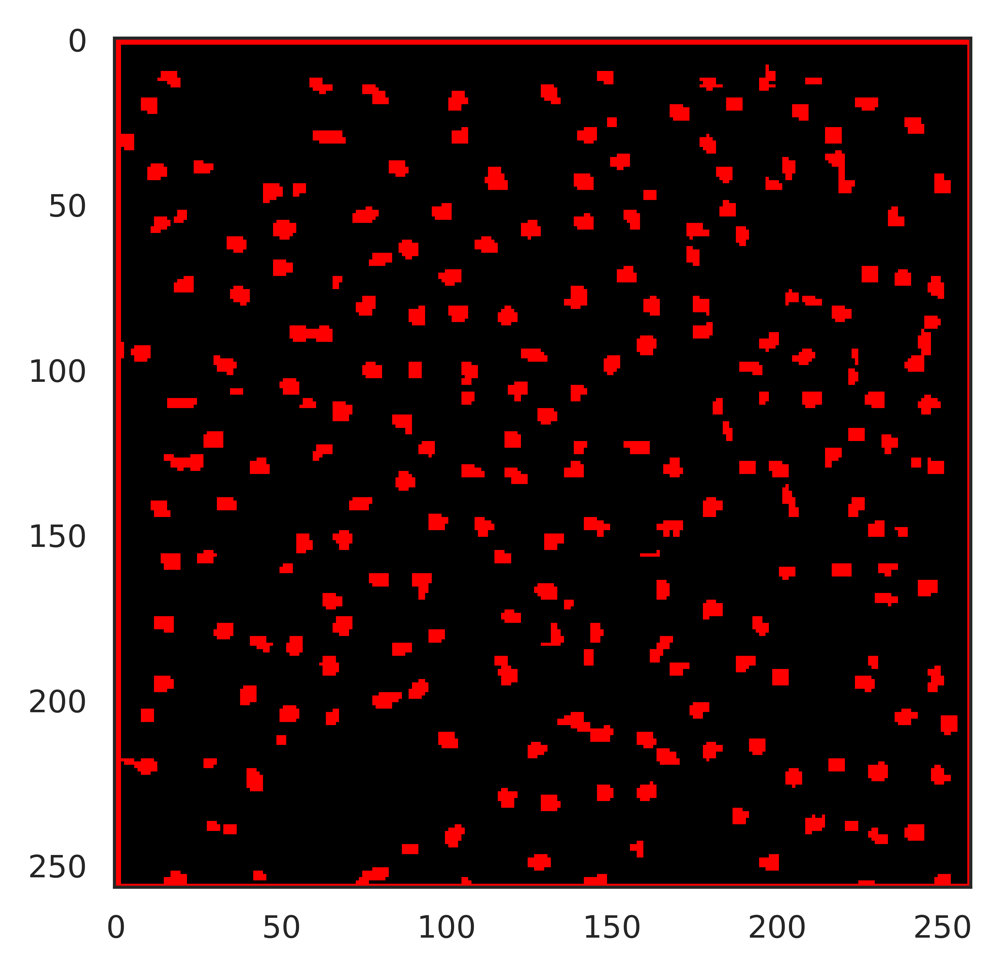

In [225]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [226]:
Cut_256_bool


Array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 0, ..., 0, 0, 1],
       ...,
       [1, 1, 0, ..., 0, 0, 1],
       [1, 1, 0, ..., 0, 0, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [227]:
Cut_256_bool_new = Cut_256_bool[2:-1, 2:-1]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [228]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [229]:
Cut_256_bool_new.shape


(254, 256)

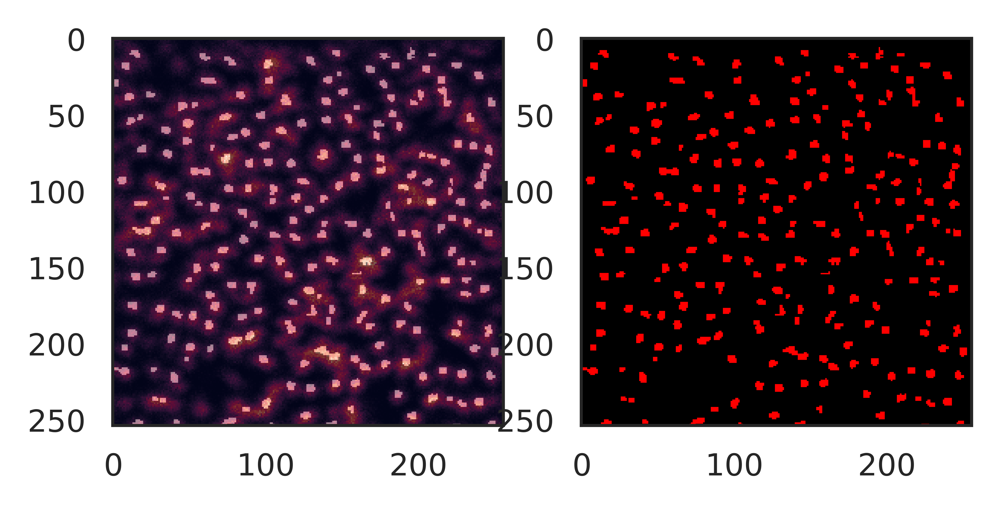

In [230]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new, bg_label=0))



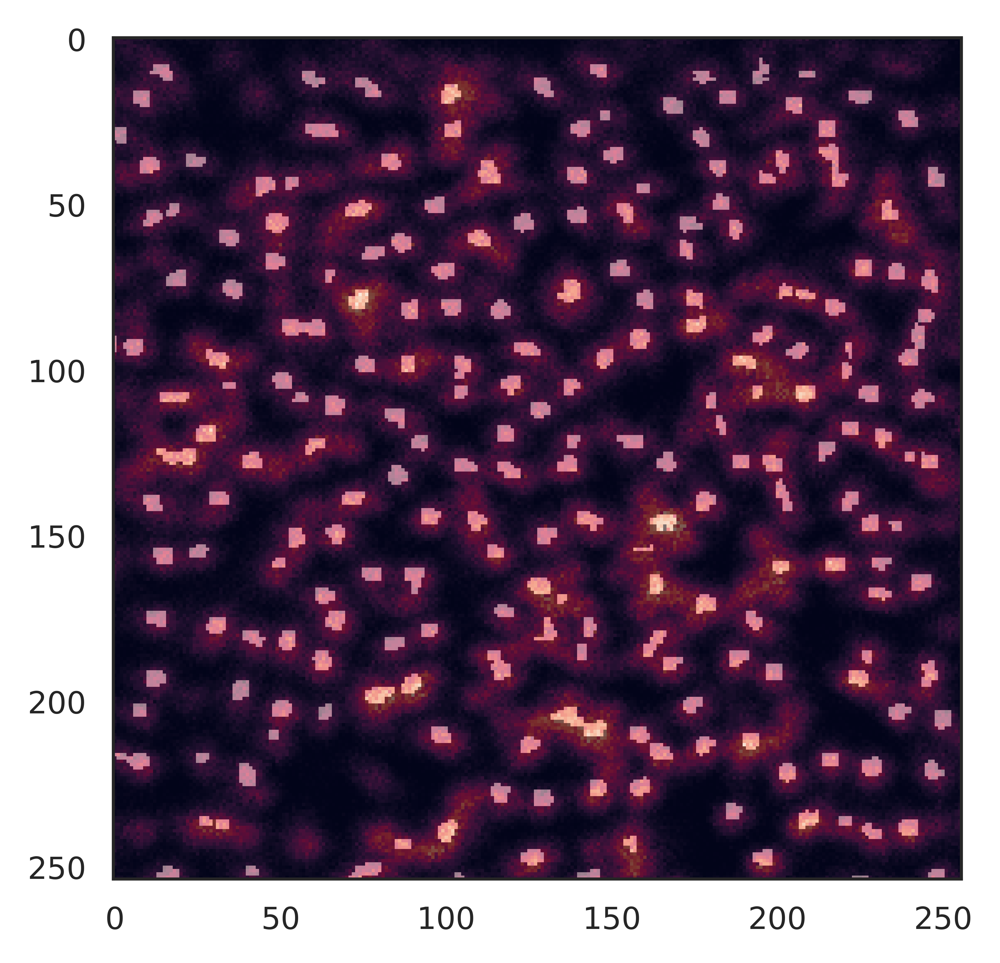

In [231]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new, alpha=0.5)



In [232]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[2:, :] = Cut_256_bool_new



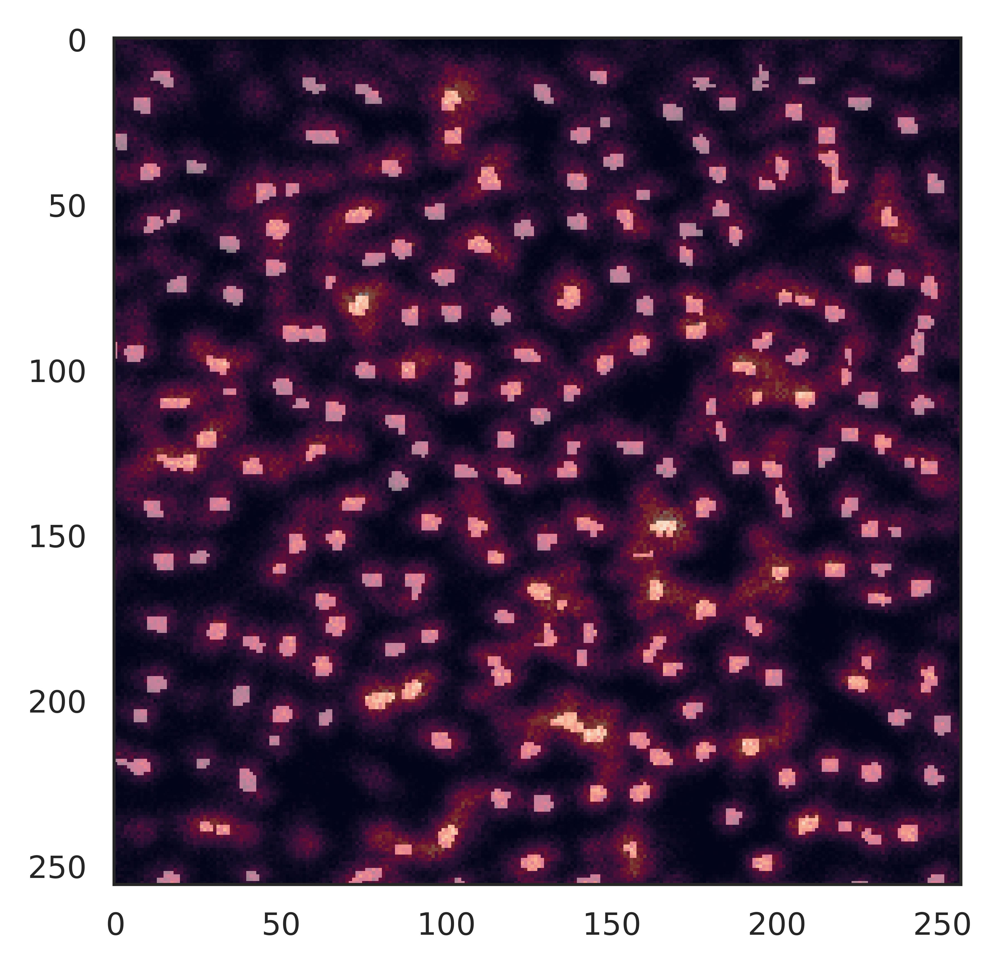

In [233]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [234]:
sample_mask_dict_new["SK"] = Cut_256_bool_new2



### compare Cut256 and SIMS (MCF7)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [235]:
tissue = "MCF7"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


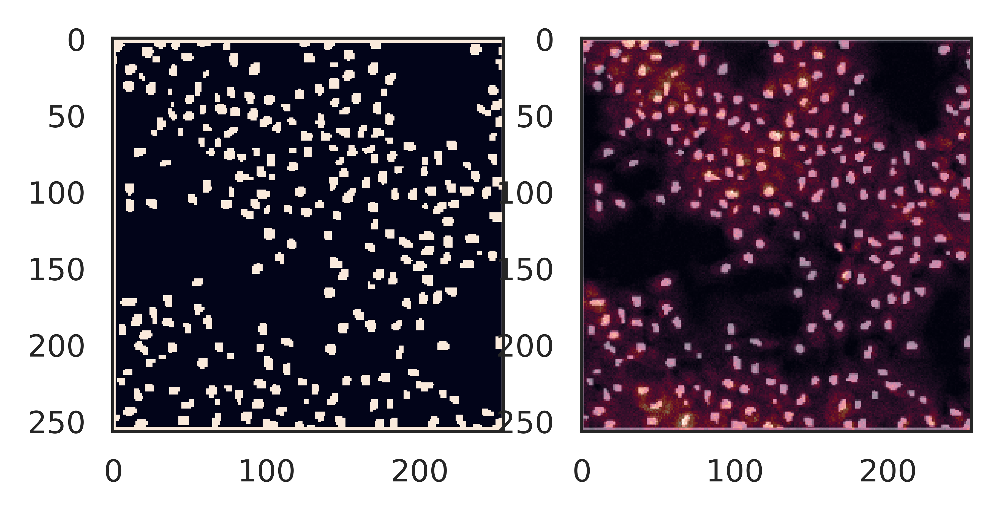

In [236]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


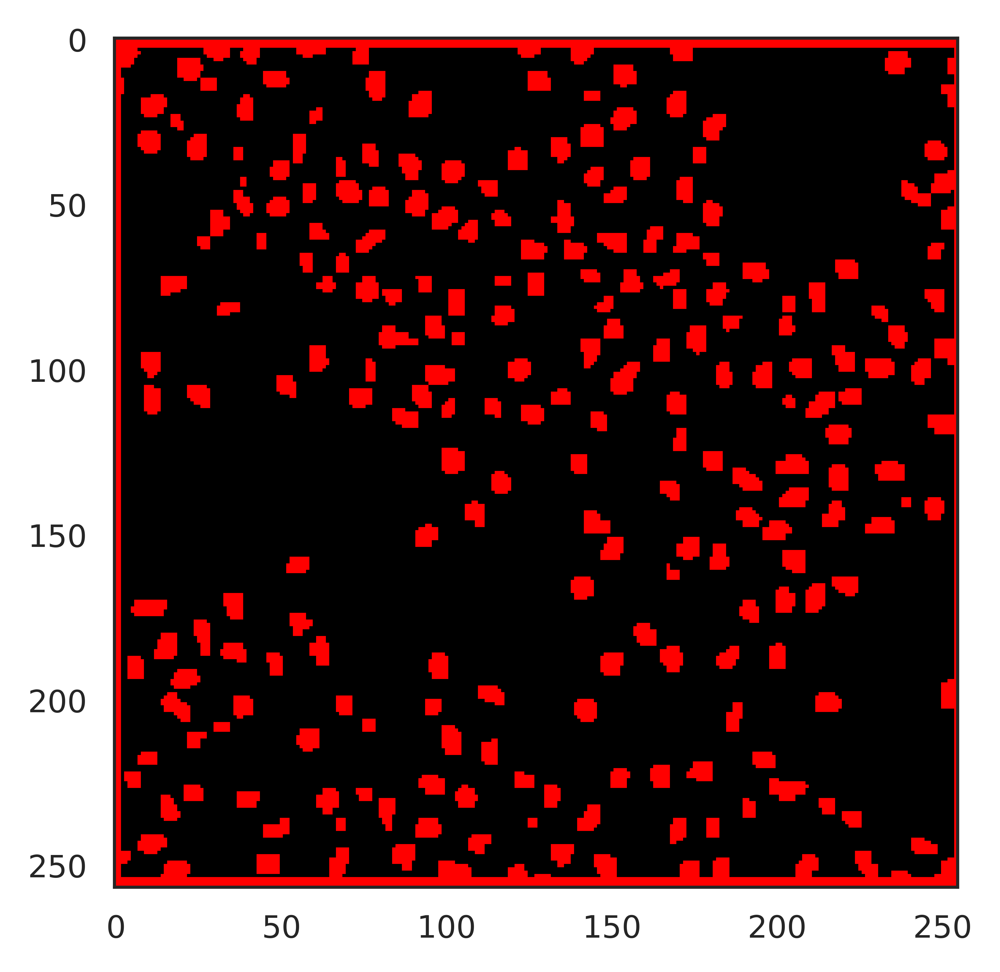

In [237]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [238]:
Cut_256_bool_new = Cut_256_bool[3:-4, 2:-1]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [239]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

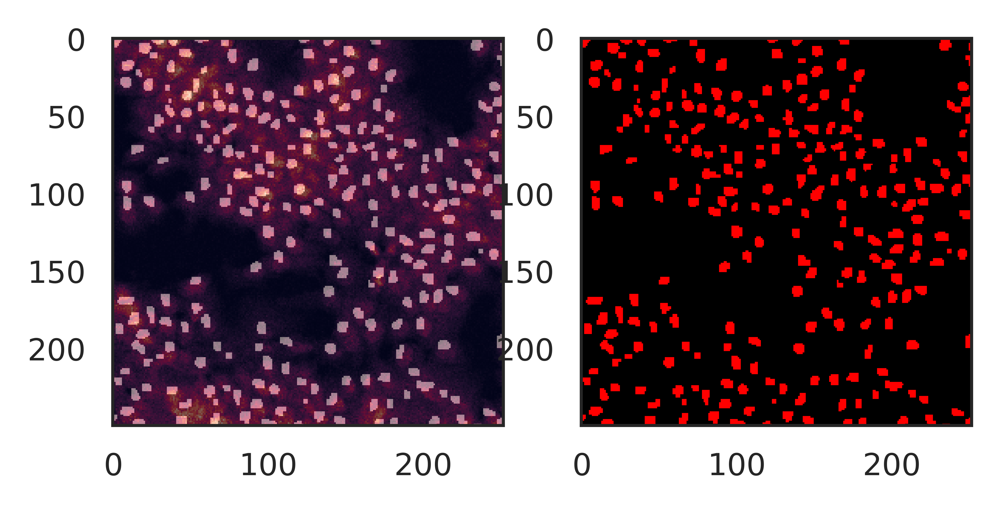

In [240]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new, bg_label=0))



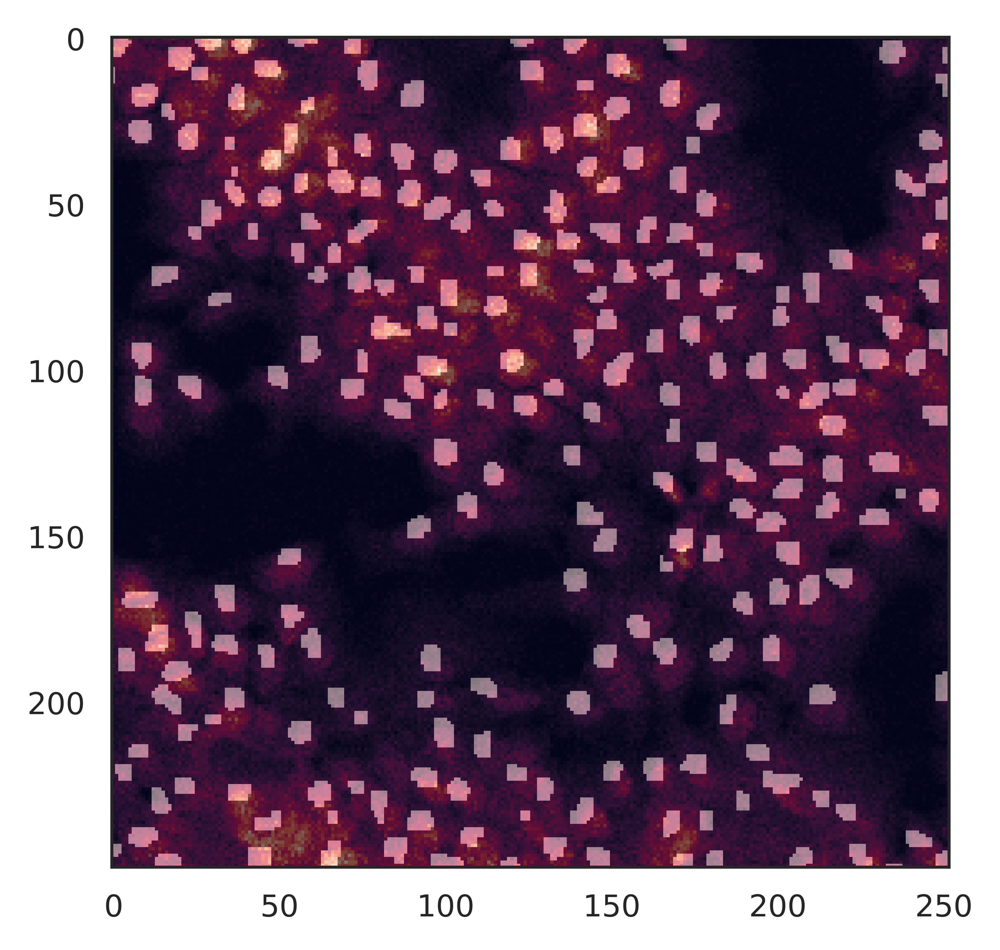

In [241]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new, alpha=0.5)



In [242]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[2:-4, 2:-2] = Cut_256_bool_new



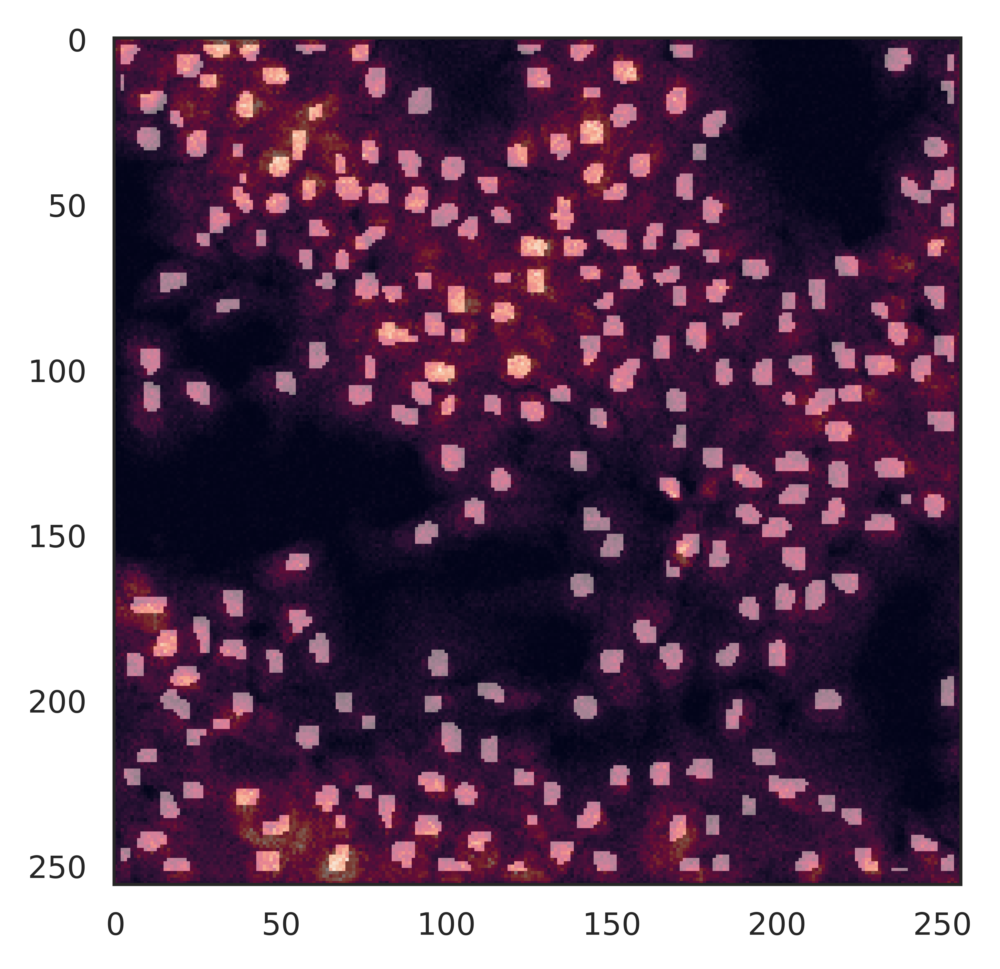

In [243]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [244]:
sample_mask_dict_new["MCF7"] = Cut_256_bool_new2



### compare Cut256 and SIMS (Lung)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [245]:
tissue = "Lung"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


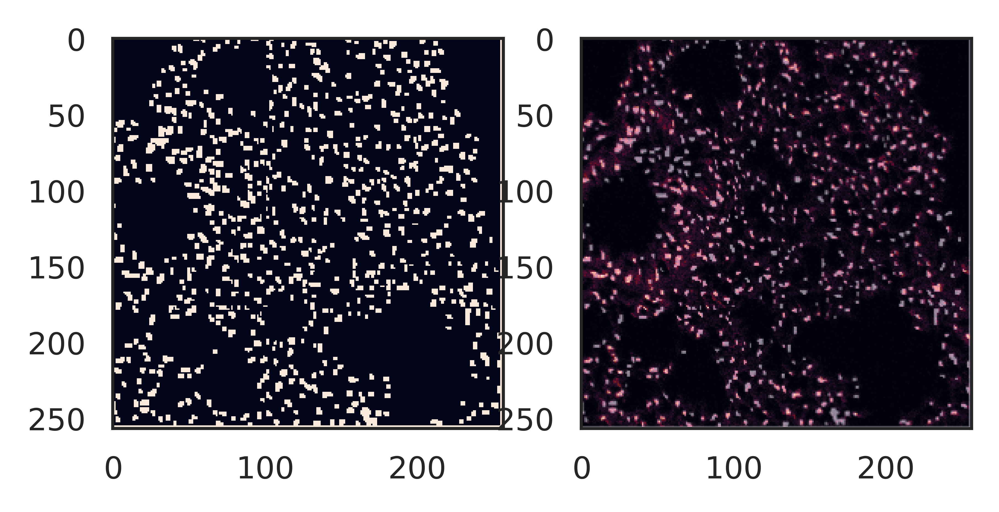

In [246]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


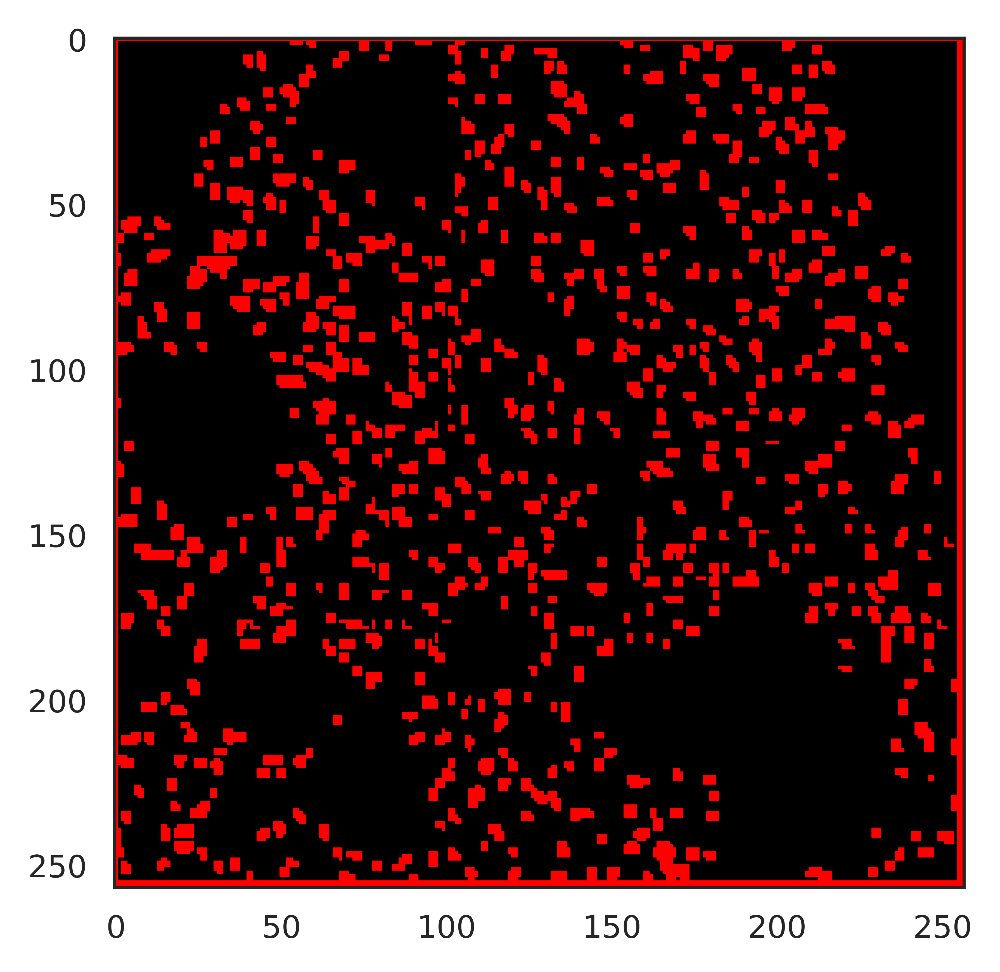

In [247]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [253]:
Cut_256_bool_new.shape


(254, 254)

In [250]:
Cut_256_bool_new = Cut_256_bool[1:-2, 1:-2]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [251]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [254]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[1:-1, 1:-1] = Cut_256_bool_new



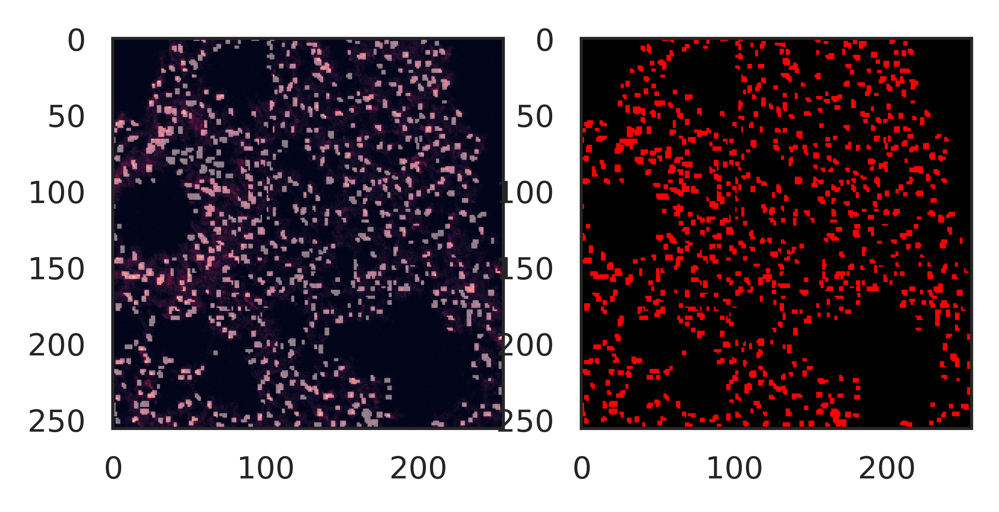

In [255]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new2, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new2, bg_label=0))



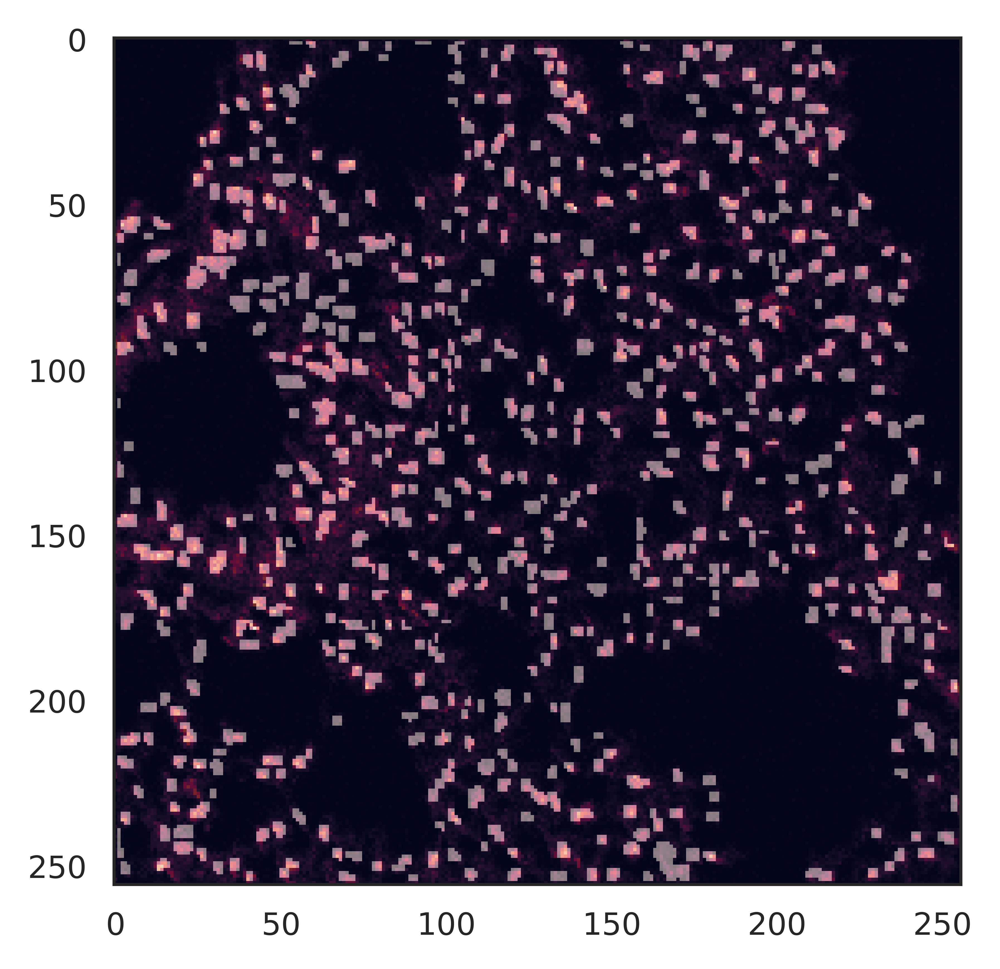

In [256]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [257]:
sample_mask_dict_new["Lung"] = Cut_256_bool_new2



In [266]:
tmp = np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]])



In [268]:
tmp[0:, :]



array([[1, 2, 3],
       [4, 5, 6],
       [7, 8, 9]])

### compare Cut256 and SIMS (Liver_3)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [258]:
tissue = "Liver_3"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


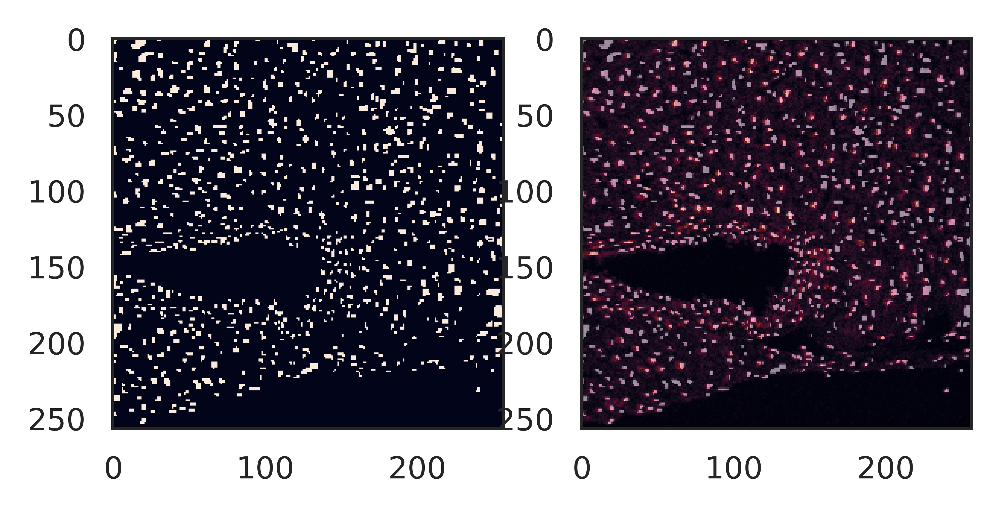

In [259]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


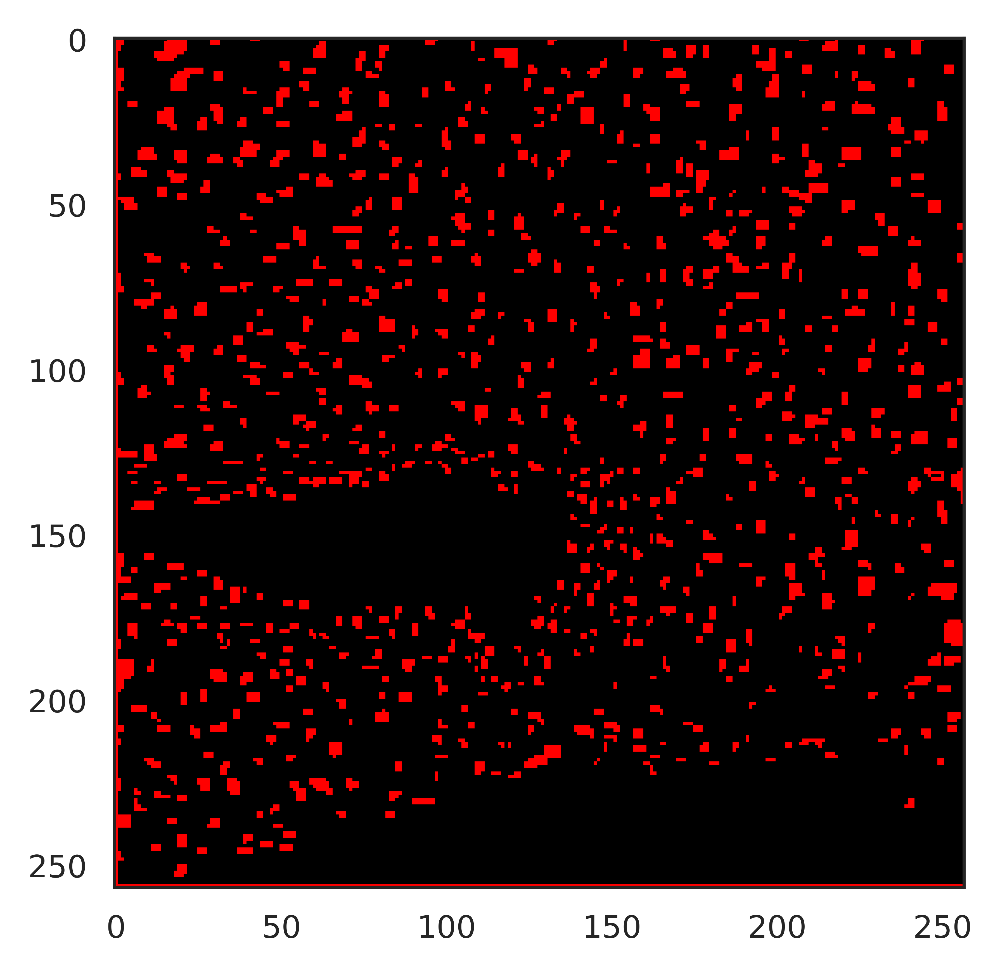

In [260]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [272]:
Cut_256_bool[:, -1]



Array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1])

In [273]:
Cut_256_bool_new = Cut_256_bool[0:-1, 1:]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [274]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

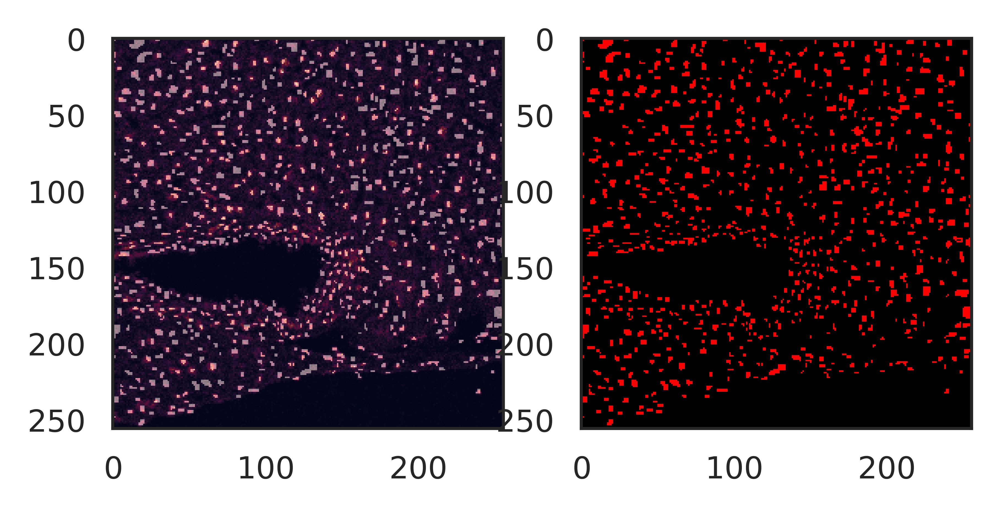

In [275]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new, bg_label=0))



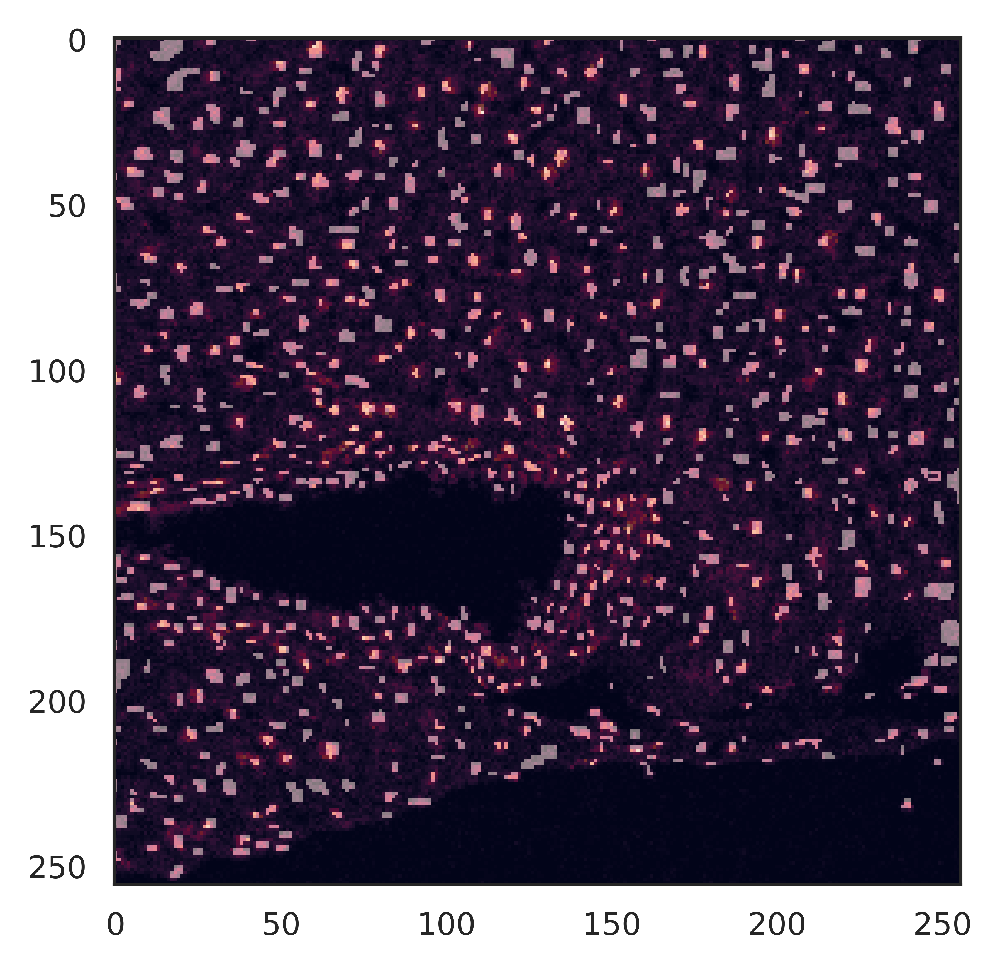

In [276]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [278]:
sample_mask_dict_new["Liver_3"] = Cut_256_bool_new



In [279]:
len(sample_mask_dict_new)


5

### compare Cut256 and SIMS (Liver_2)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [280]:
tissue = "Liver_2"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


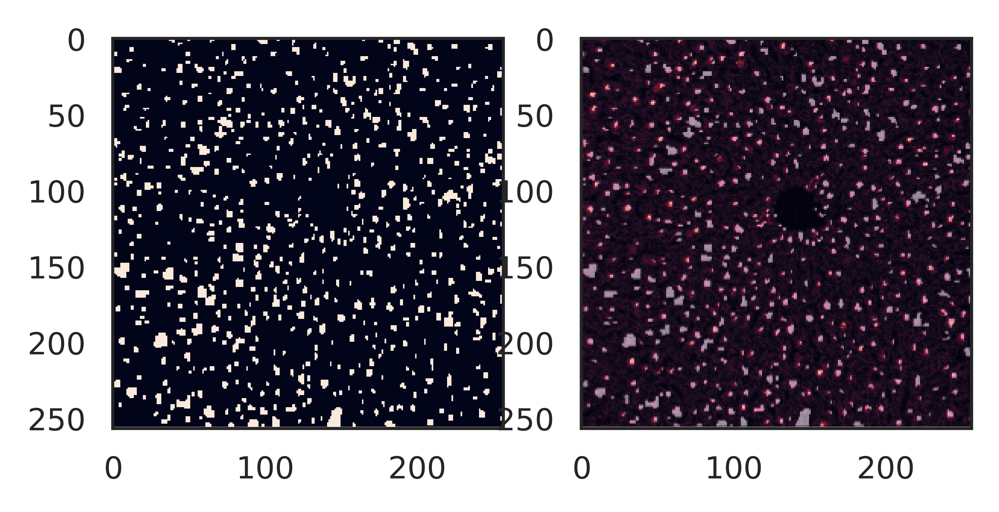

In [281]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


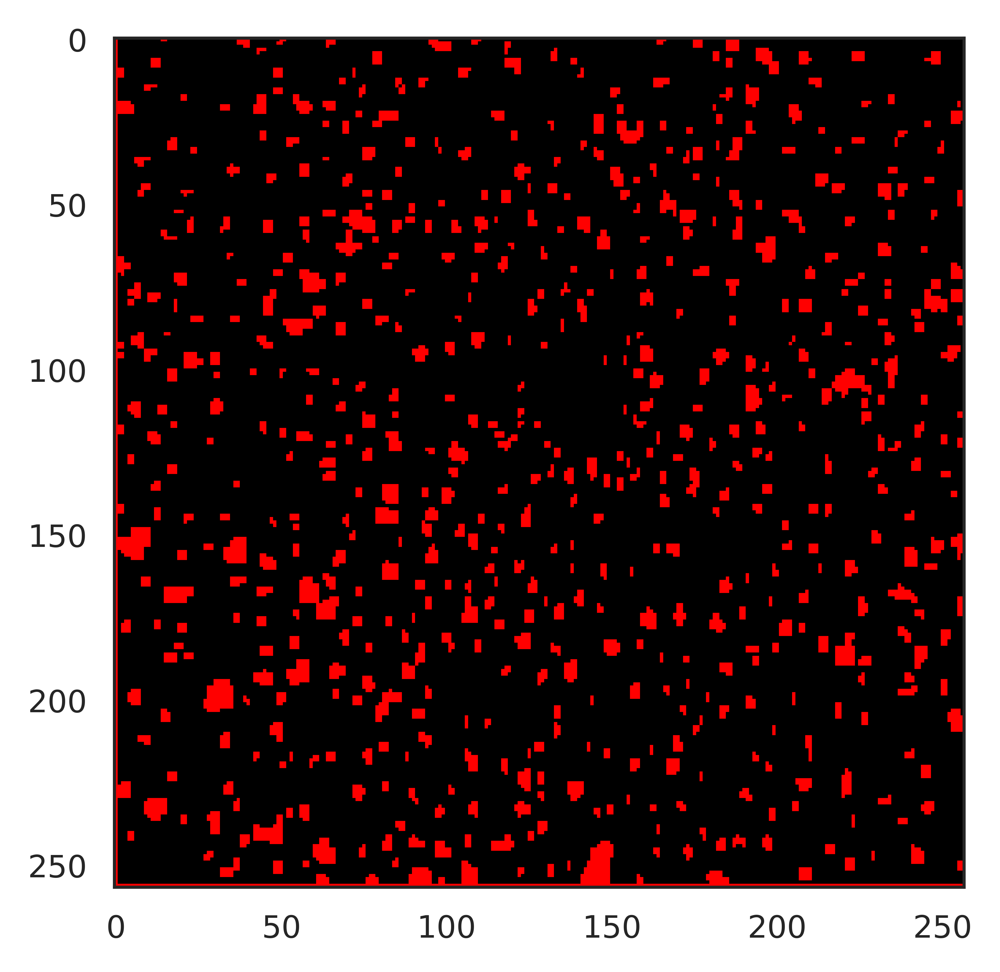

In [282]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [283]:
Cut_256_bool_new = Cut_256_bool[0:-1, 1:]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [284]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [285]:
Cut_256_bool_new.shape


(256, 256)

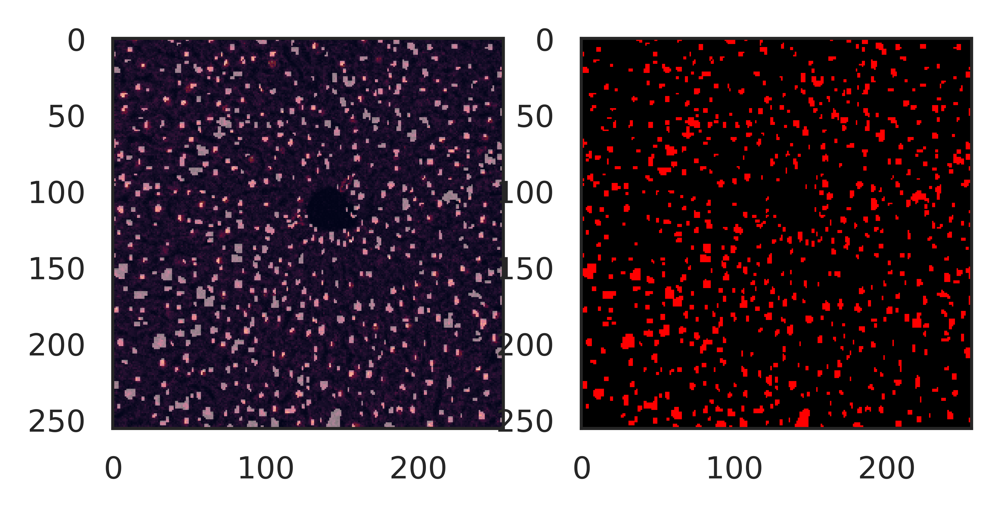

In [286]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new, bg_label=0))



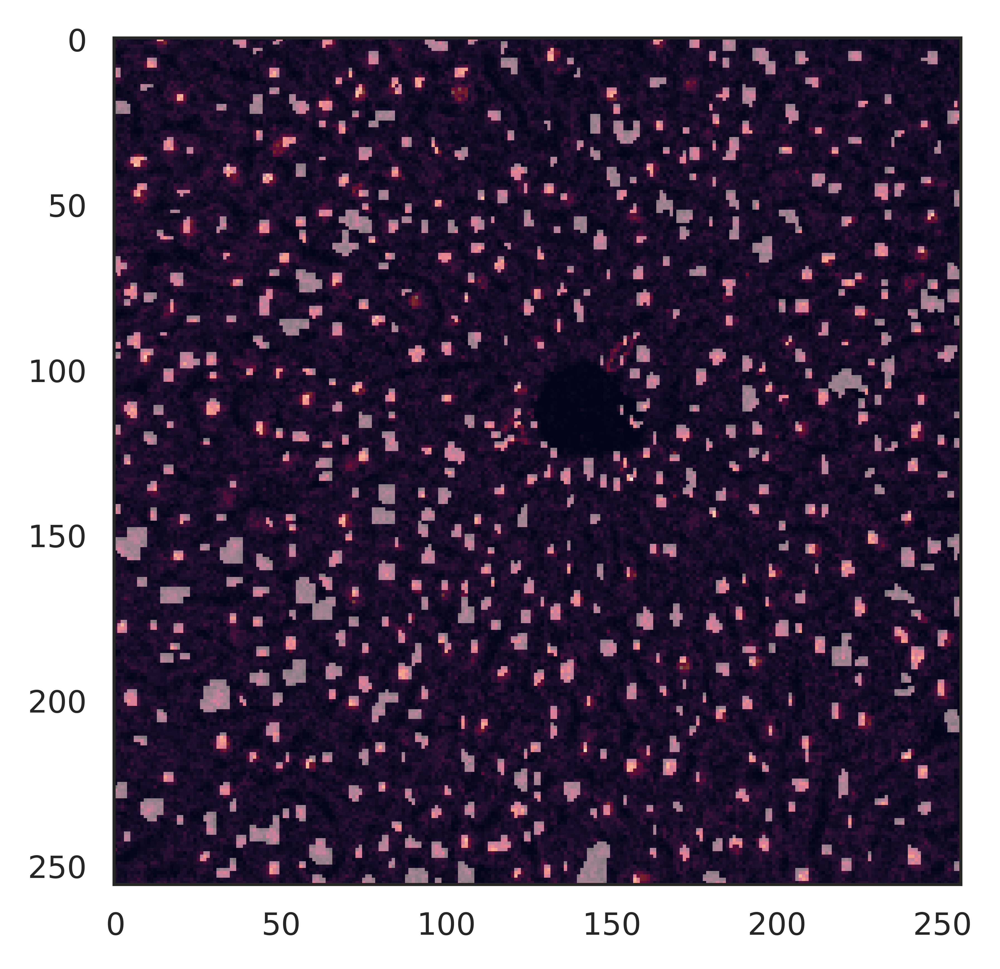

In [287]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [288]:
sample_mask_dict_new["Liver_2"] = Cut_256_bool_new



### compare Cut256 and SIMS (Hela)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [289]:
tissue = "Hela"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


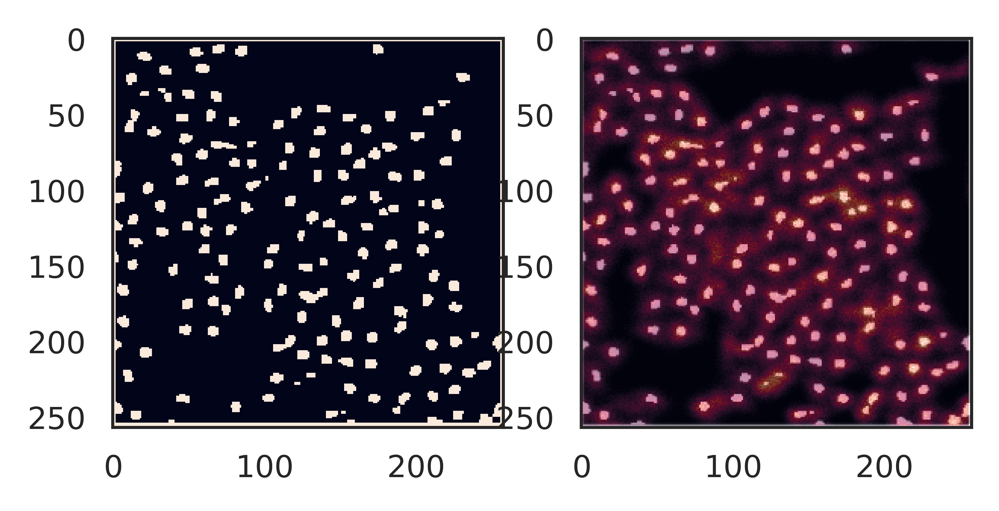

In [290]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


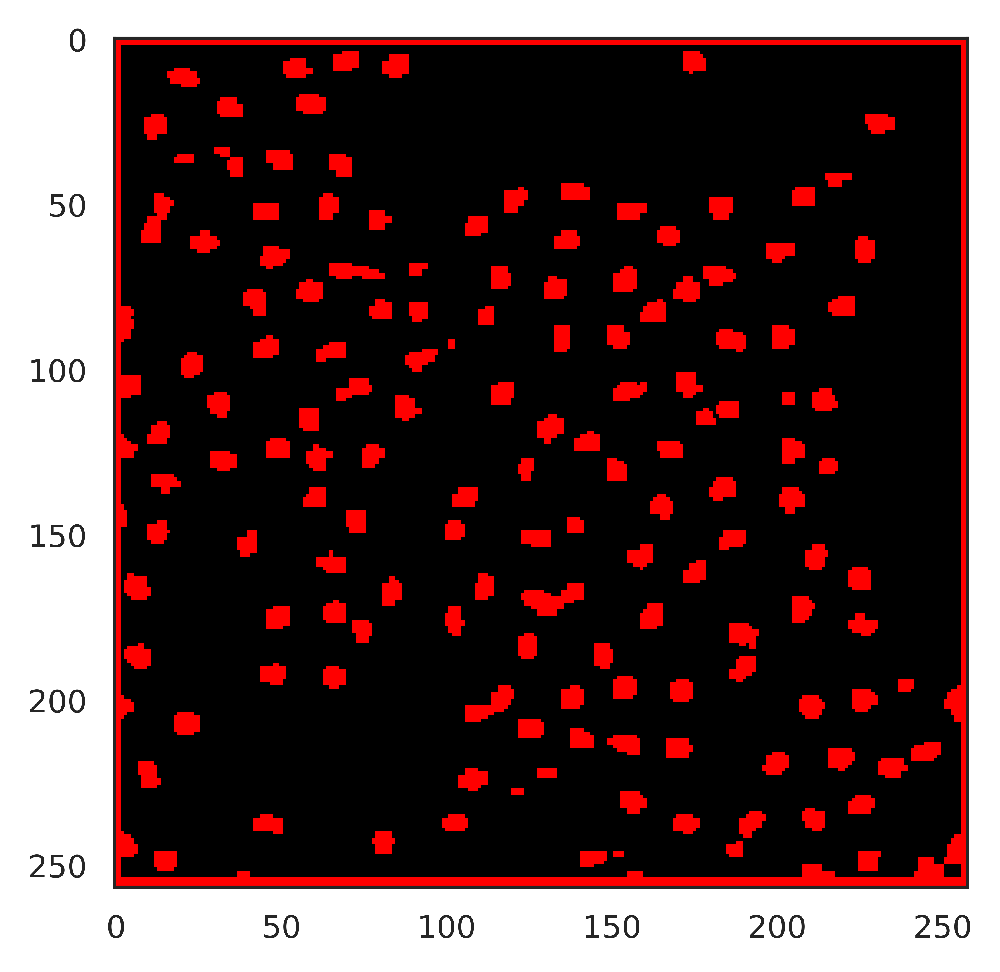

In [291]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [306]:
Cut_256_bool[:, -3]



Array([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1])

In [307]:
Cut_256_bool_new = Cut_256_bool[2:-3, 2:-2]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [308]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158], dtype=int32),
 array([57656,    43,    40,    48,    43,    46,    48,    42,    45,
           45, 

In [309]:
Cut_256_bool_new.shape


(252, 254)

In [312]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[1:-3, 1:-1] = Cut_256_bool_new



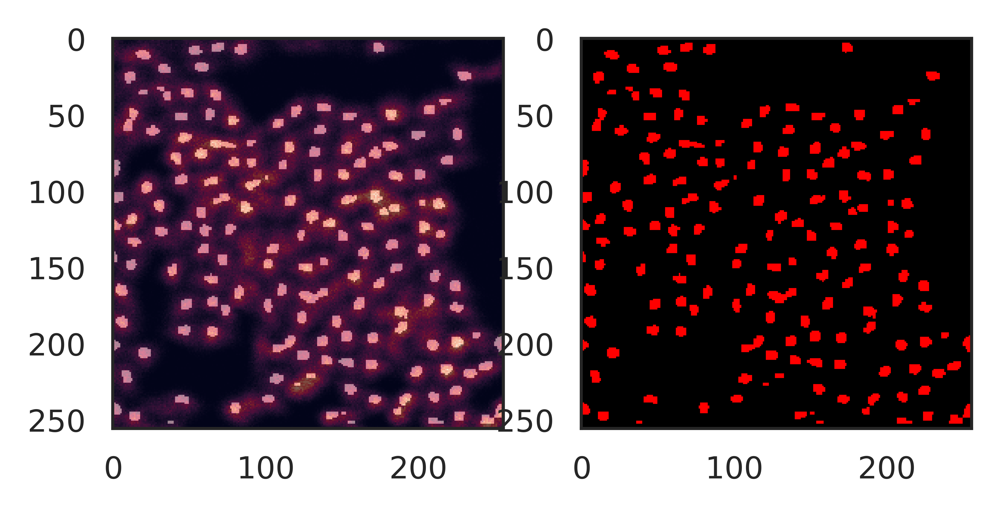

In [314]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new2, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new2, bg_label=0))



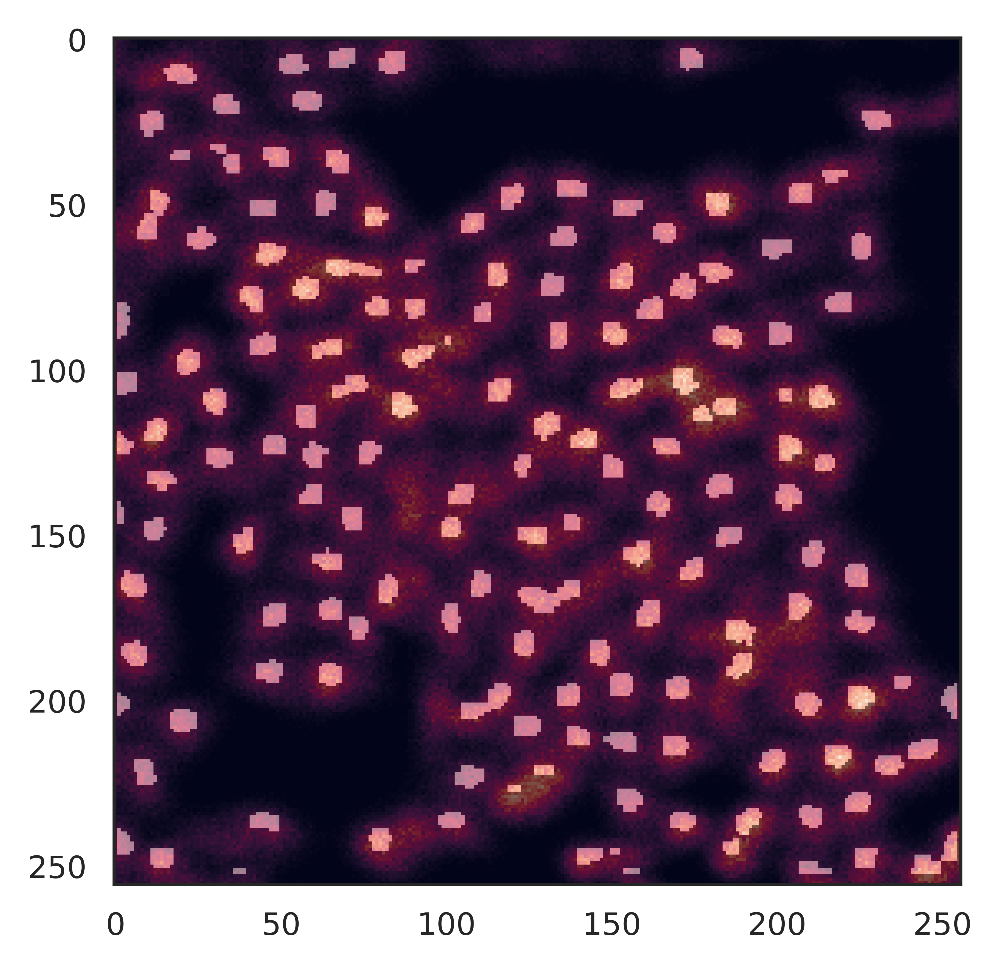

In [315]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [316]:
sample_mask_dict_new["Hela"] = Cut_256_bool_new2



### compare Cut256 and SIMS (A549)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [317]:
tissue = "A549"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


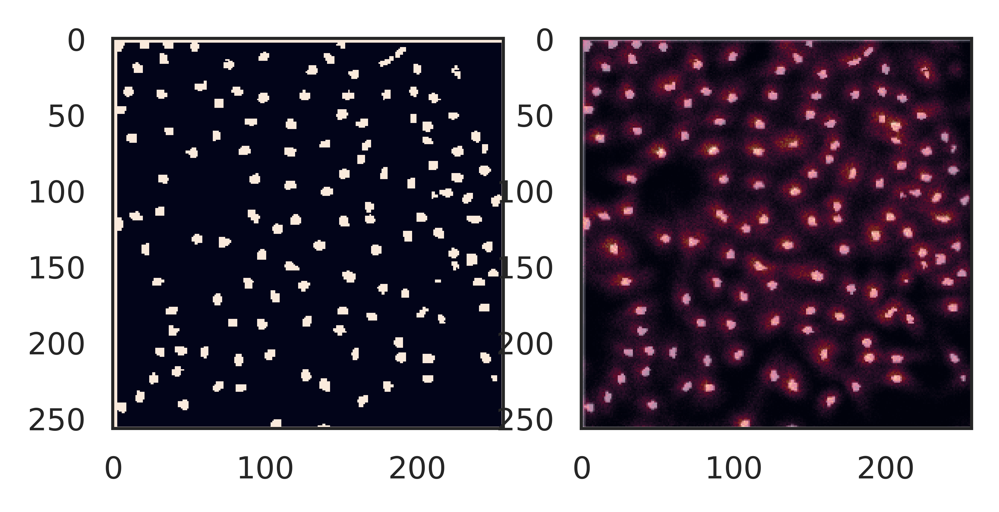

In [318]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


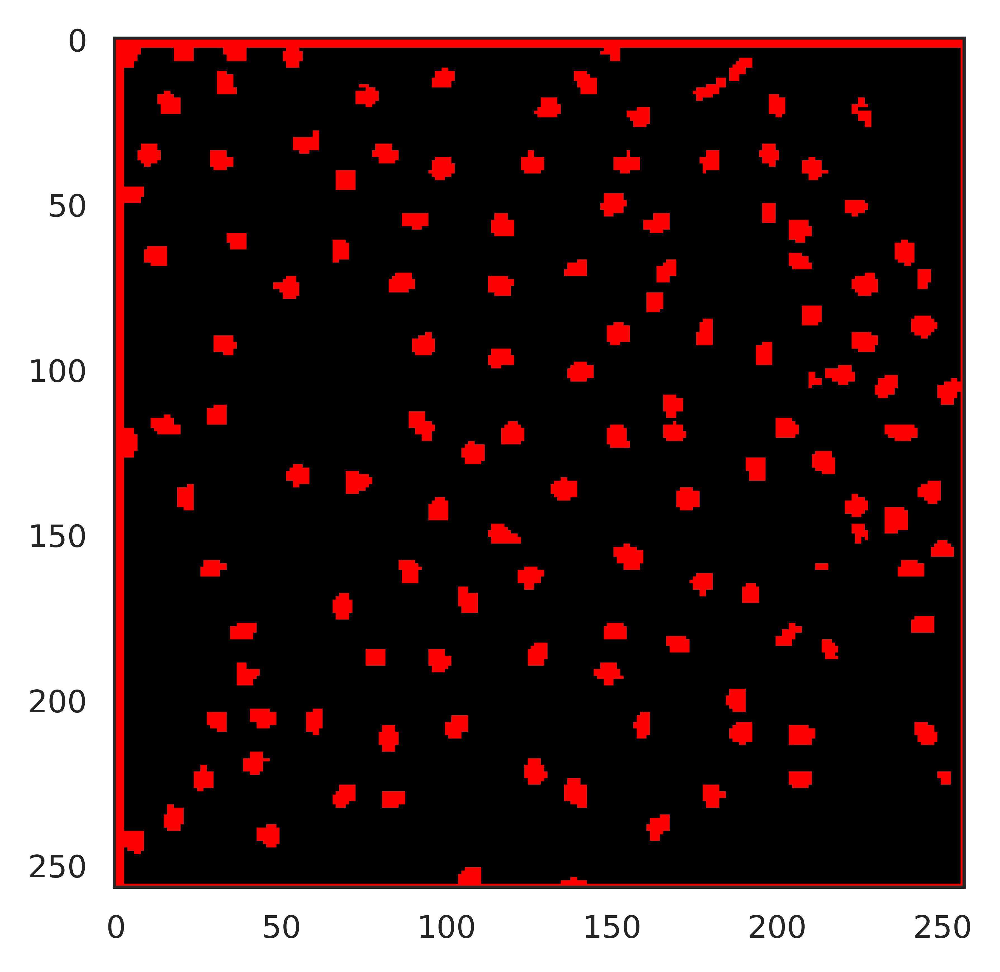

In [319]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [329]:
Cut_256_bool[:, -2]



Array([1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1])

In [330]:
Cut_256_bool_new = Cut_256_bool[3:-1, 3:-1]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [331]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133], dtype=int32),
 array([59297,    24,    24,    26,    30,    17,    31,    33,    35,
           38,    34,    35,    39,    30,    37,    29,    33,    39,
           38,    37,    31,    35,    37,    37,    31,    42,    35,
           36,

In [333]:
Cut_256_bool.shape


(257, 257)

In [332]:
Cut_256_bool_new.shape


(253, 253)

In [337]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[3:, 3:] = Cut_256_bool_new



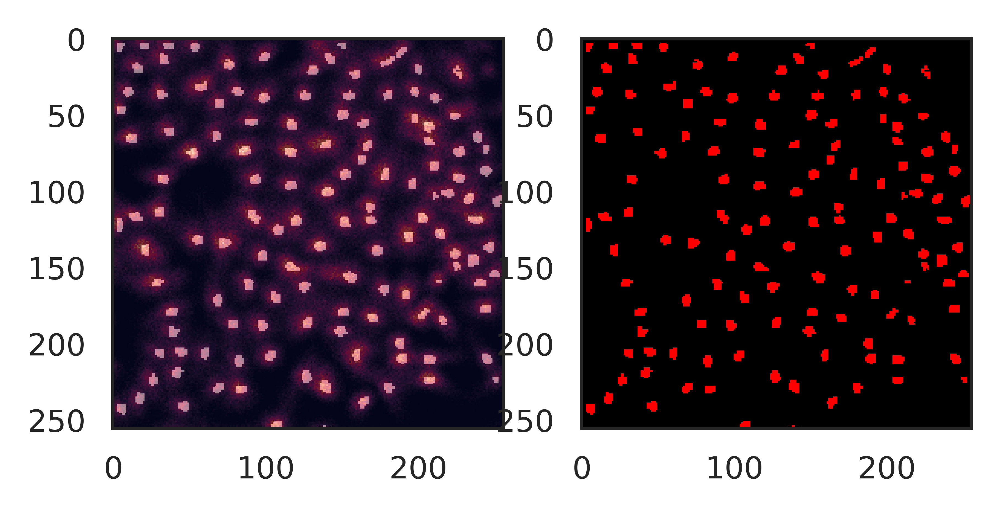

In [338]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new2, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new2, bg_label=0))



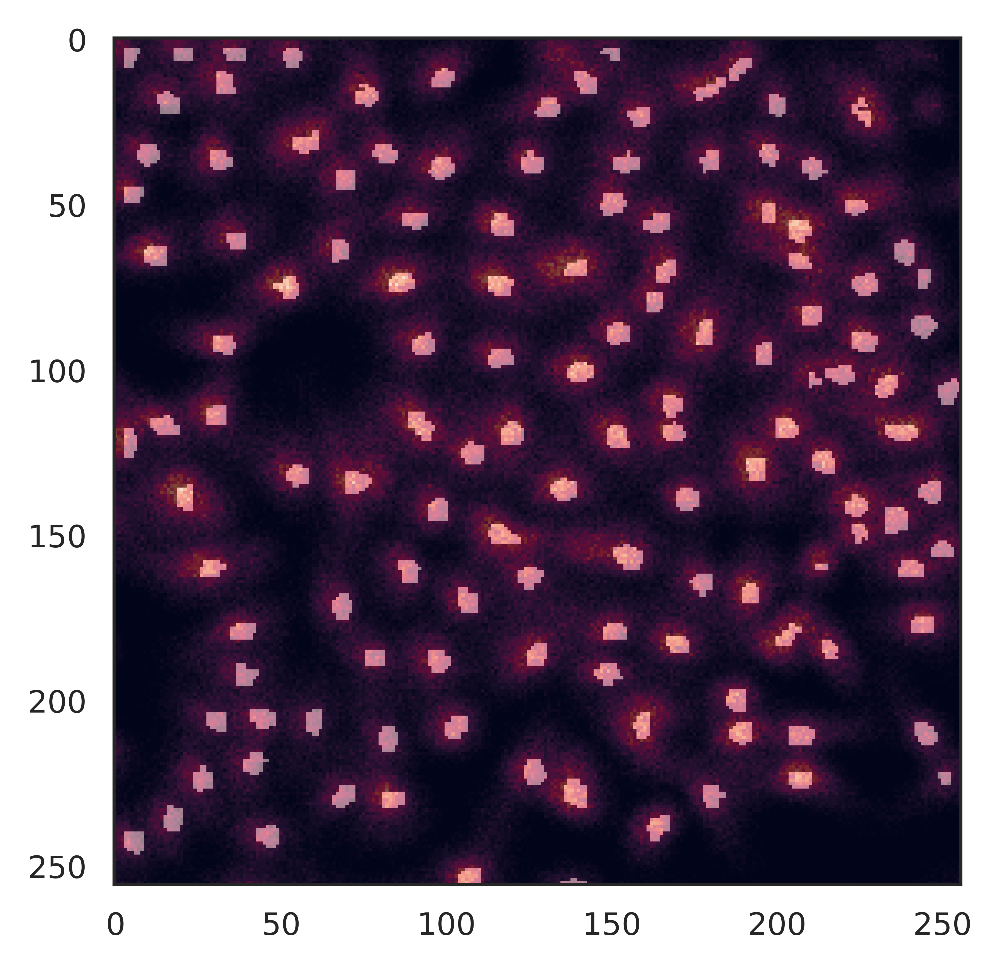

In [340]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [341]:
sample_mask_dict_new["A549"] = Cut_256_bool_new2



### compare Cut256 and SIMS (10A)


In [ ]:
read_from_png_list = ["SK", "MCF7", "Lung", "Liver_3", "Liver_2", "Hela", "A549", "10A"]


In [342]:
tissue = "10A"
Cut_256_bool, Cut_256, Cut_256_int = load_segment(tissue, "Cut_256")
SIMS_256 = tissue_adenine_dict[tissue]


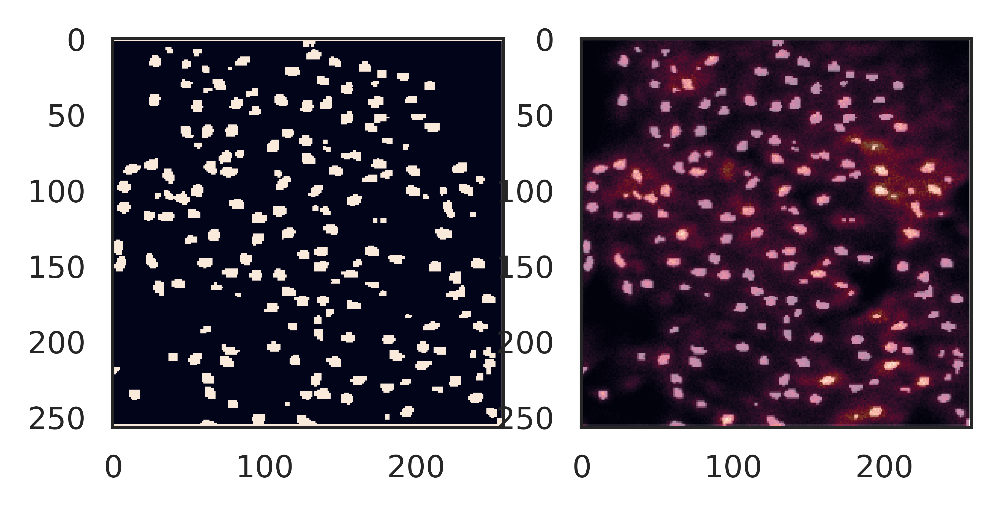

In [343]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(Cut_256_bool)

axes[1].imshow(SIMS_256)
axes[1].imshow(Cut_256, alpha=0.5)
# axes[2].imshow(Cut_256_int)


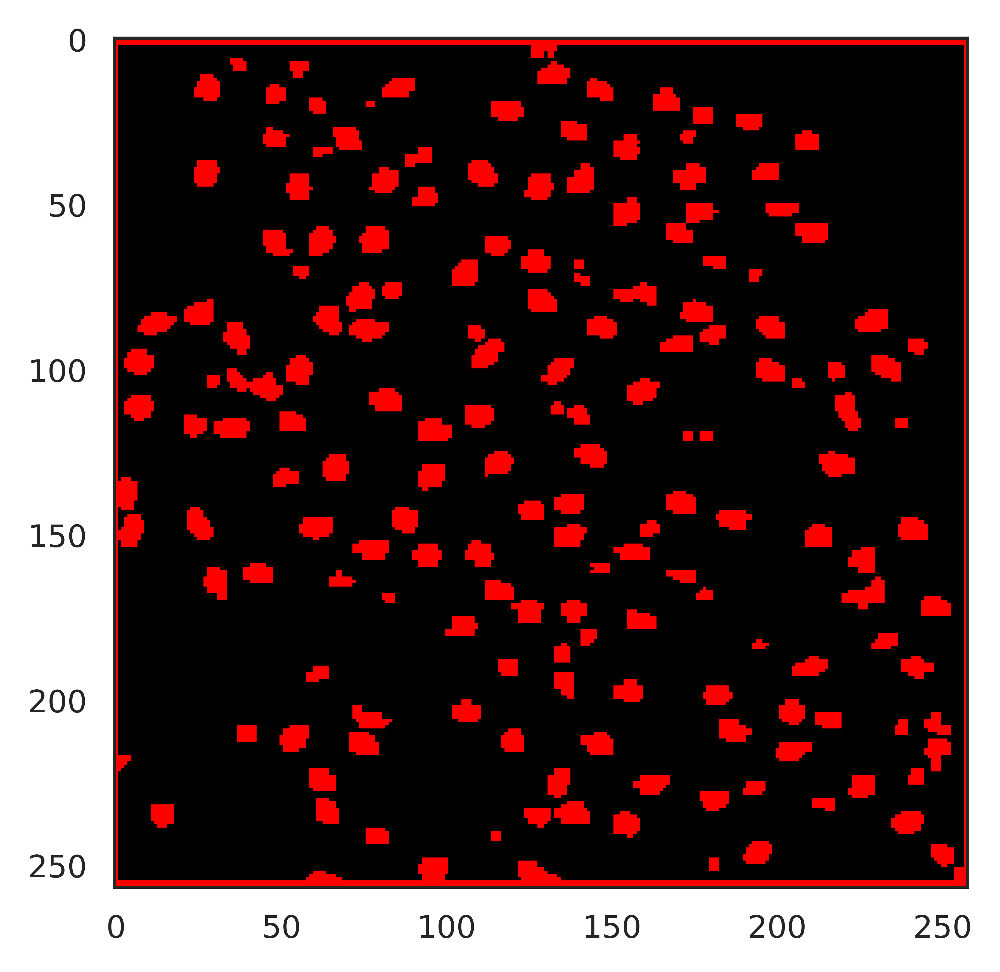

In [344]:
from skimage import color

plt.imshow(color.label2rgb(Cut_256_bool, bg_label=0))



In [354]:
Cut_256_bool[:, -2]



Array([1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1])

In [355]:
Cut_256_bool_new = Cut_256_bool[2:-2, 1:-1]
Cut_256_int, _ = ndi.label(Cut_256_bool_new)



In [356]:
np.unique(Cut_256_int, return_counts=1)



(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175], dtype=i

In [358]:
Cut_256_bool.shape


(257, 258)

In [357]:
Cut_256_bool_new.shape


(253, 256)

In [359]:
Cut_256_bool_new2 = np.zeros(shape=(256, 256))
Cut_256_bool_new2[1:-2, :] = Cut_256_bool_new



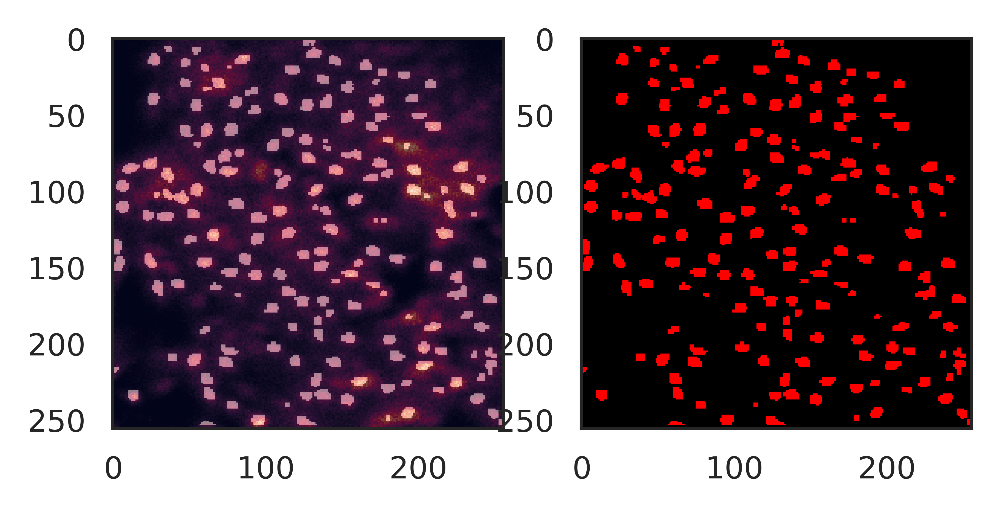

In [366]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(SIMS_256)
axes[0].imshow(Cut_256_bool_new2, alpha=0.5)
axes[1].imshow(color.label2rgb(Cut_256_bool_new2, bg_label=0))


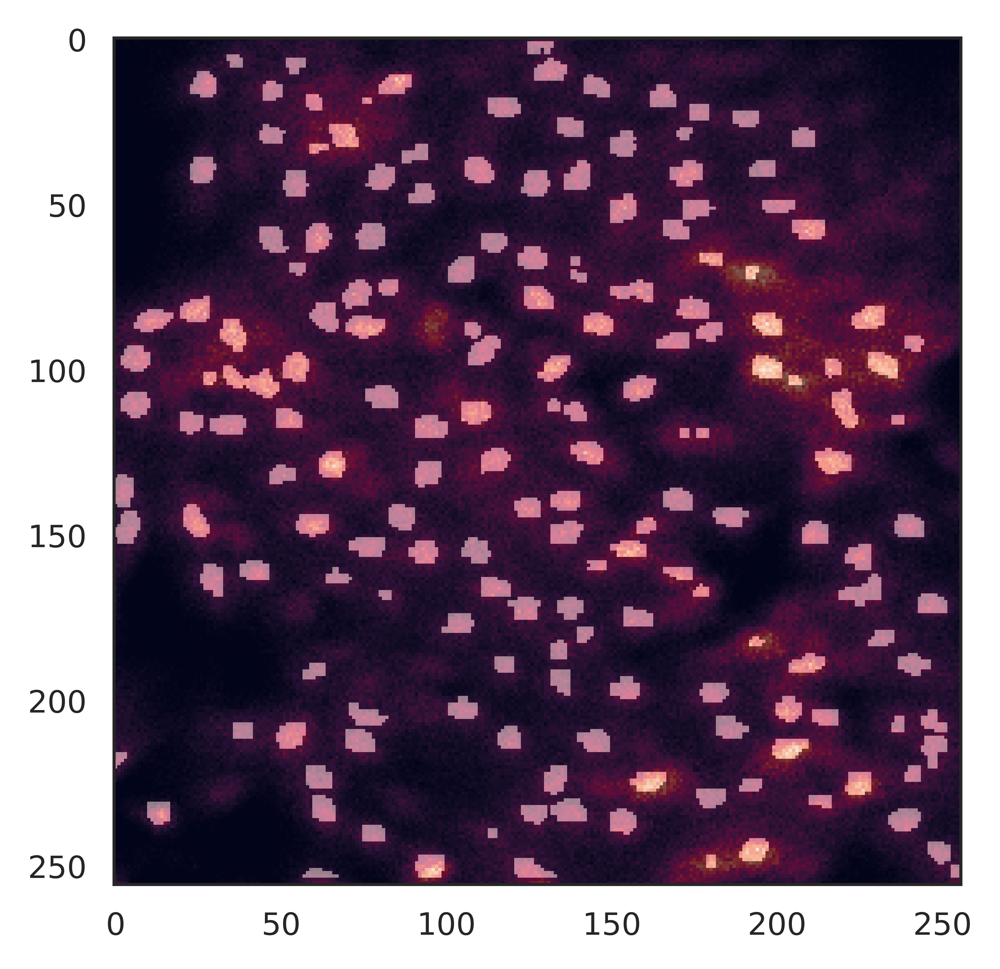

In [361]:
plt.imshow(SIMS_256)
plt.imshow(Cut_256_bool_new2, alpha=0.5)



In [173]:
sample_mask_dict_new = {}


In [362]:
sample_mask_dict_new["10A"] = Cut_256_bool_new2



### check and merge


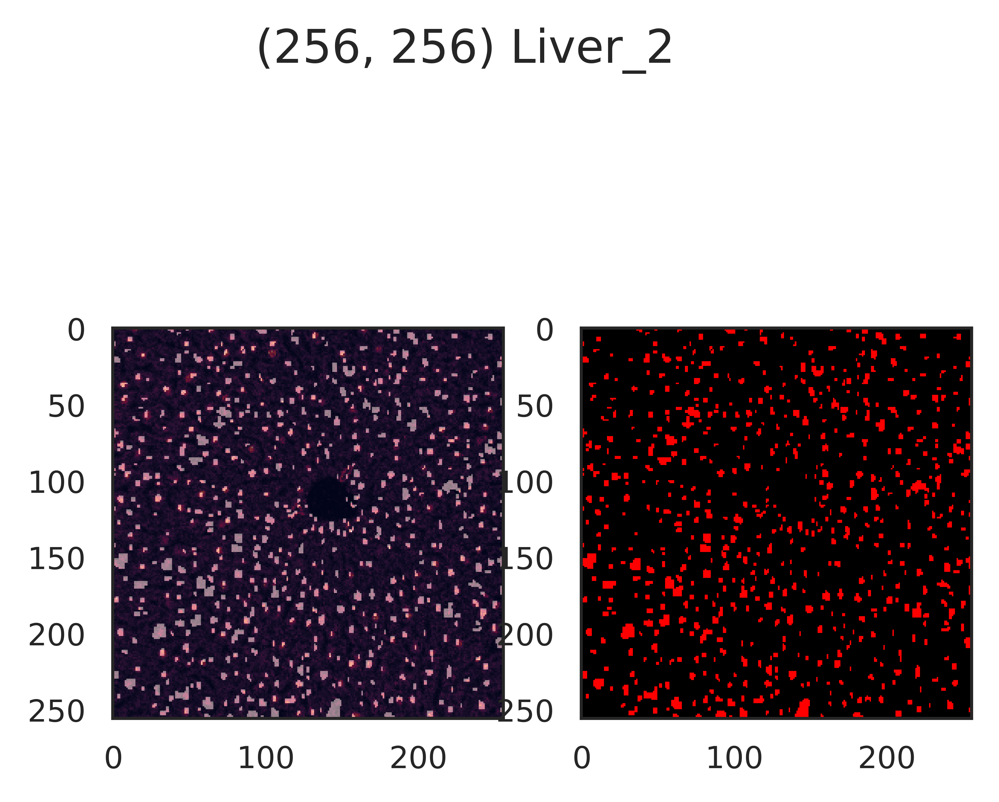

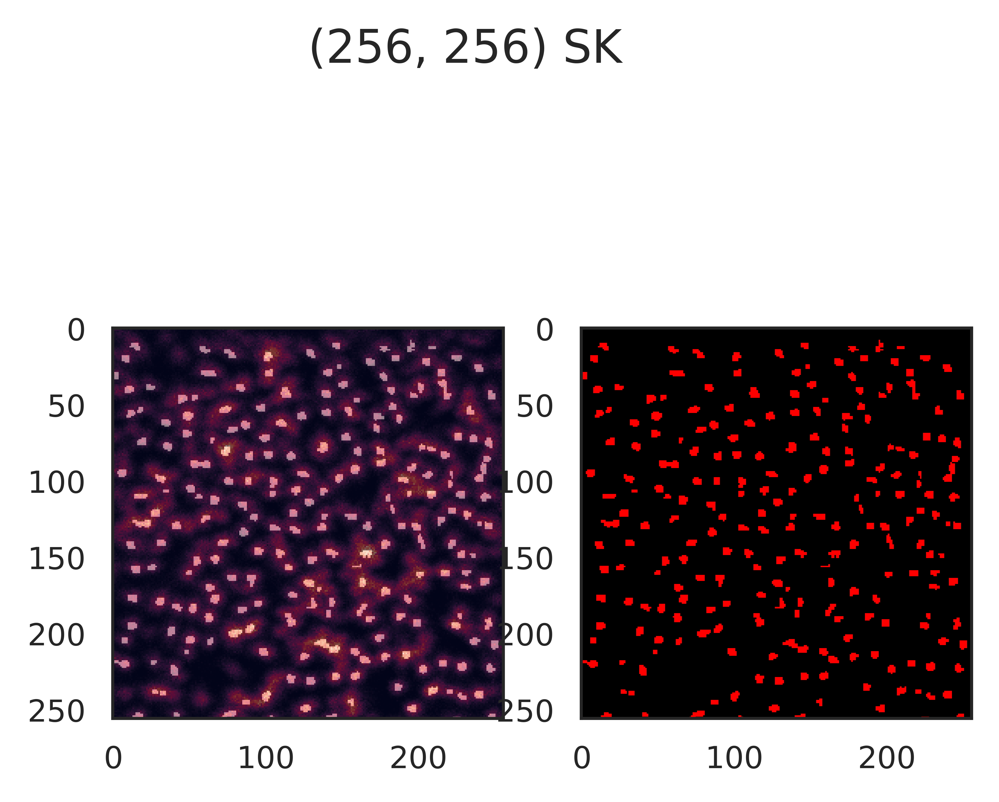

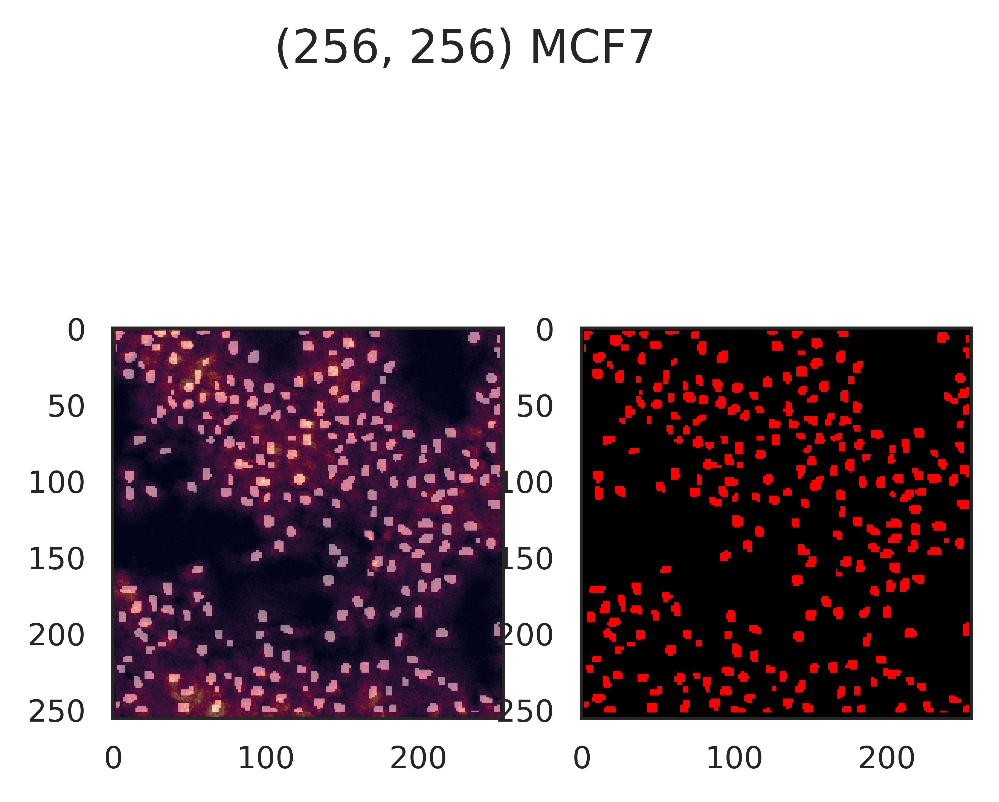

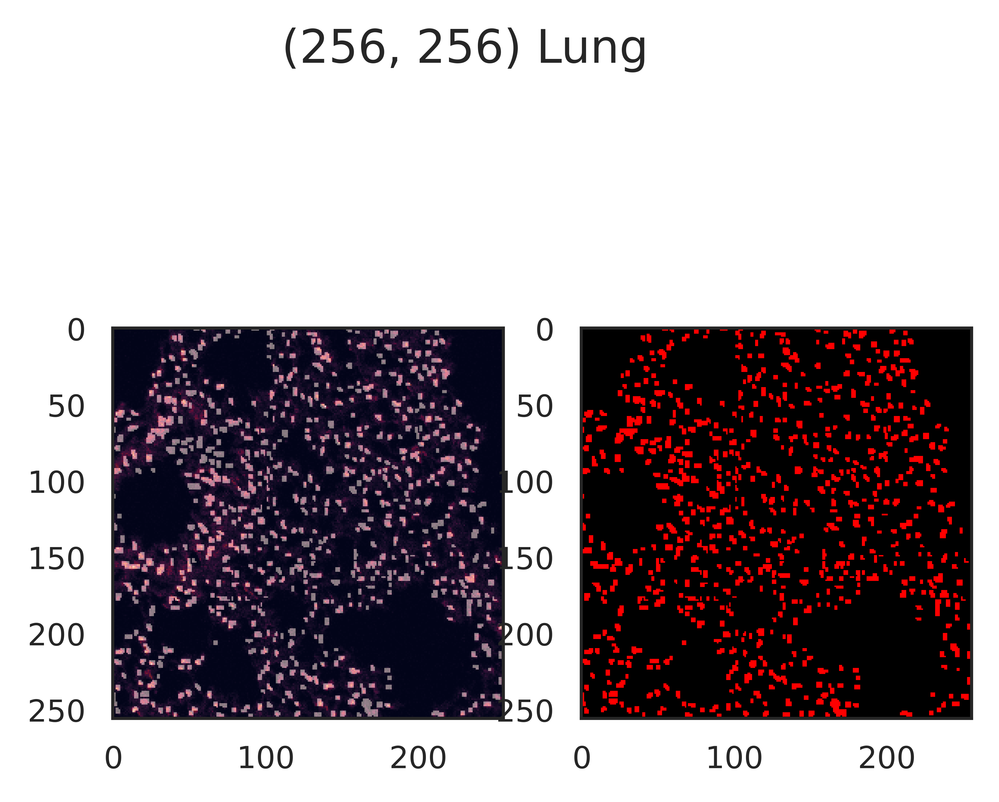

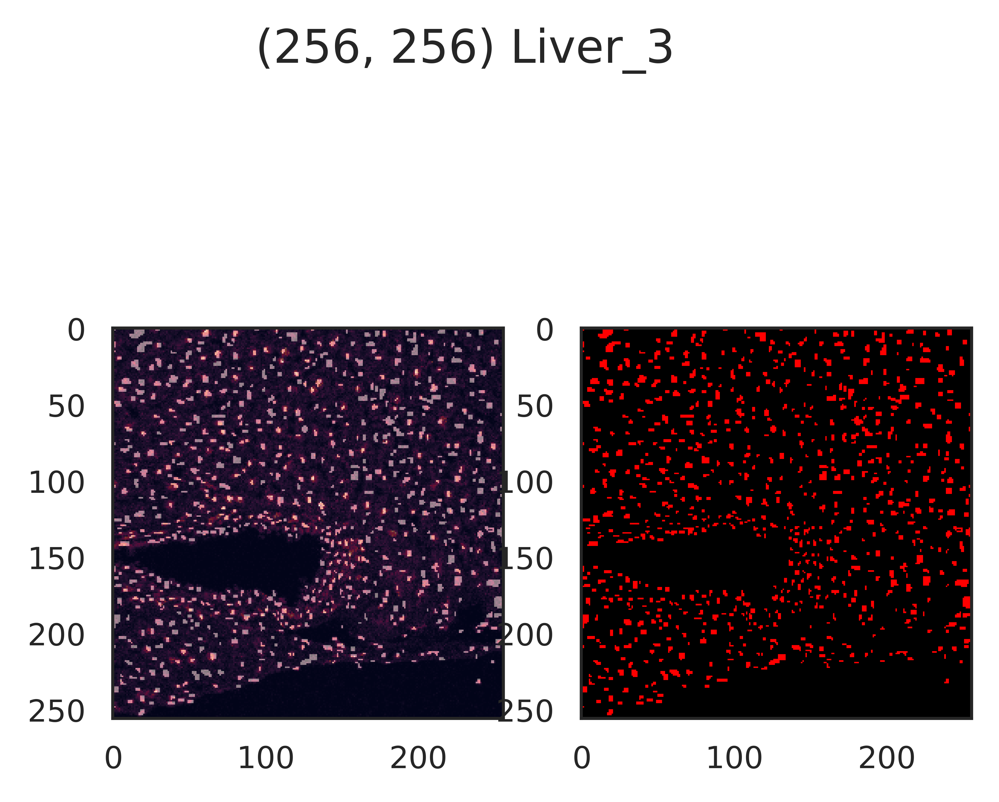

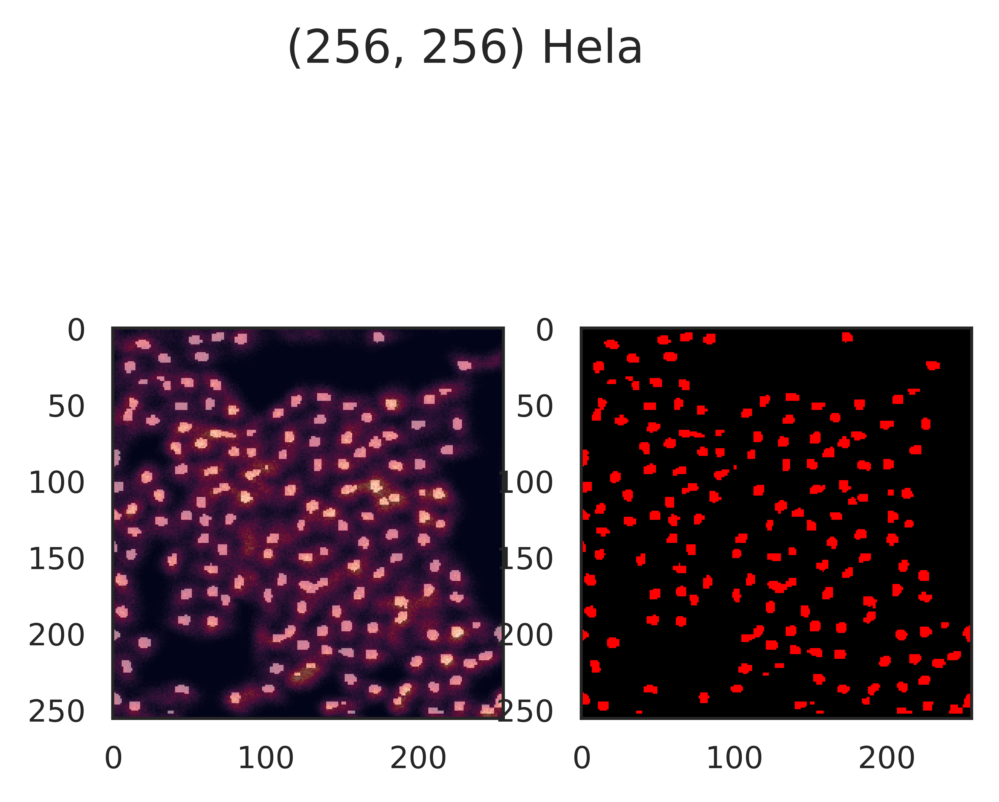

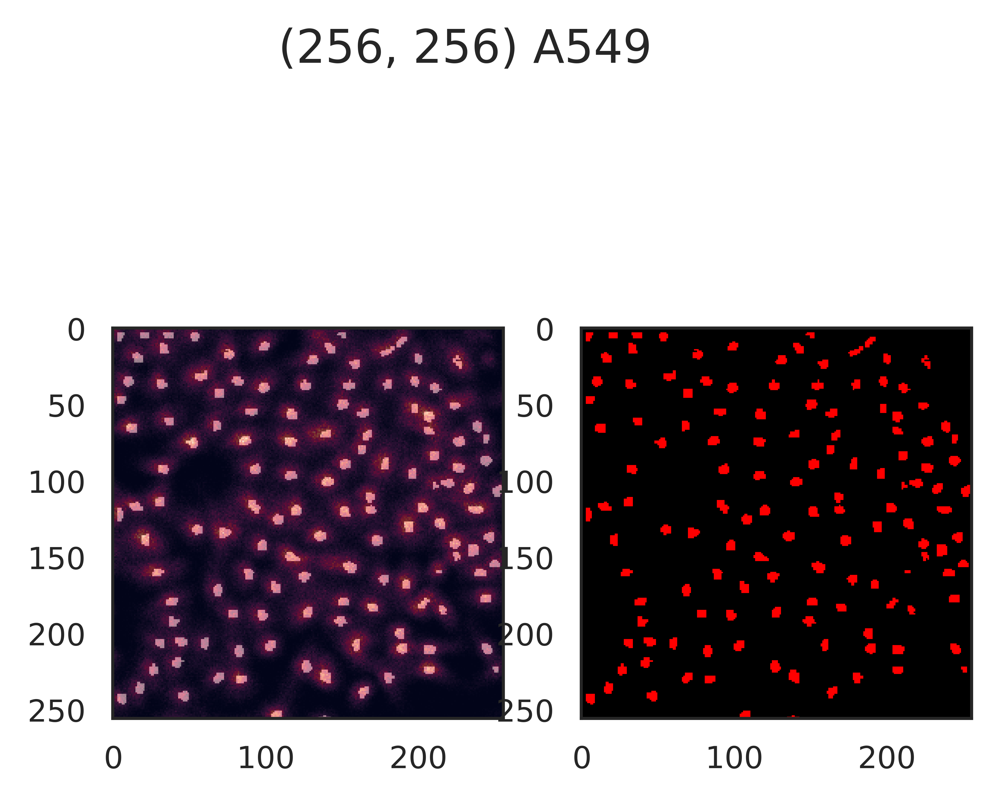

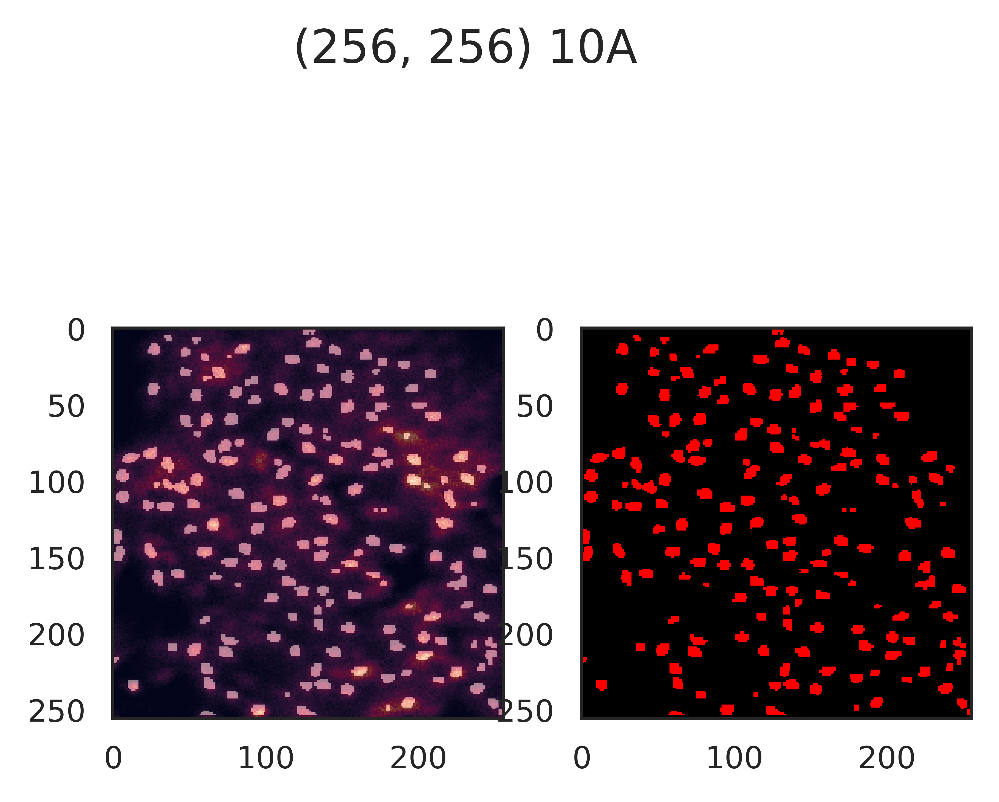

In [368]:
for key in sample_mask_dict_new.keys():
    SIMS_256 = tissue_adenine_dict[key]
    Cut_256 = sample_mask_dict_new[key]
    fig, axes = plt.subplots(1, 2)
    axes[0].imshow(SIMS_256)
    axes[0].imshow(Cut_256, alpha=0.5)
    axes[1].imshow(color.label2rgb(Cut_256, bg_label=0))
    fig.suptitle("{1} {0}".format(key, str(Cut_256.shape)))



In [370]:
sample_mask_dict_all = {**sample_mask_dict, **sample_mask_dict_new}



### final check


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


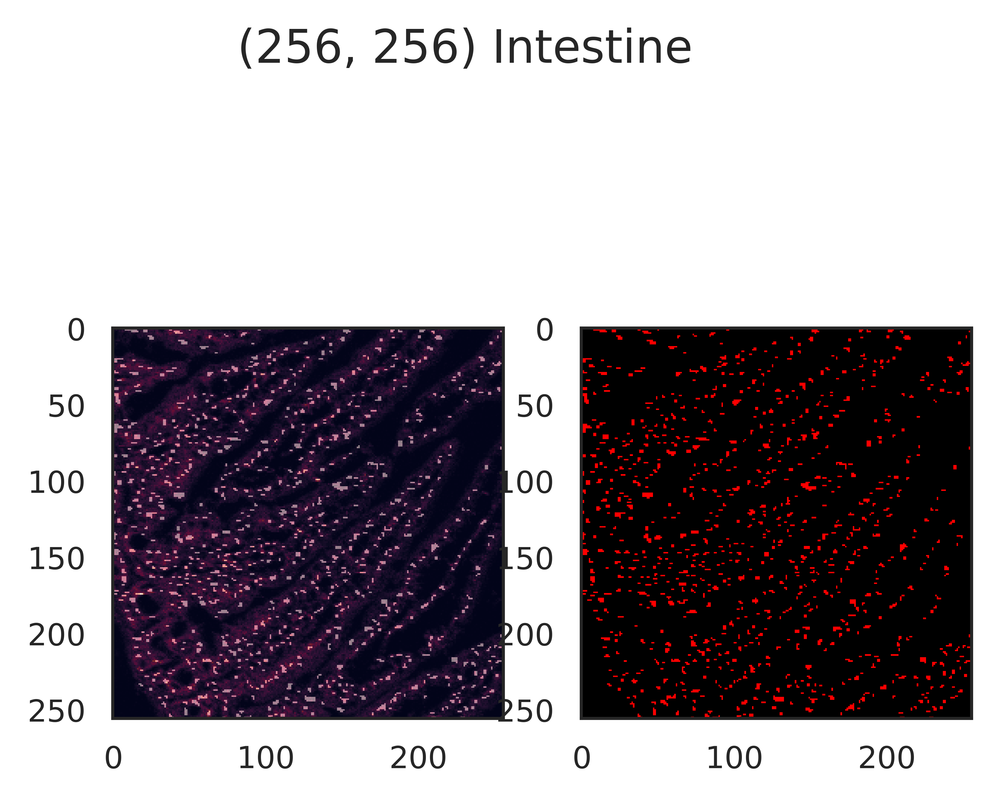

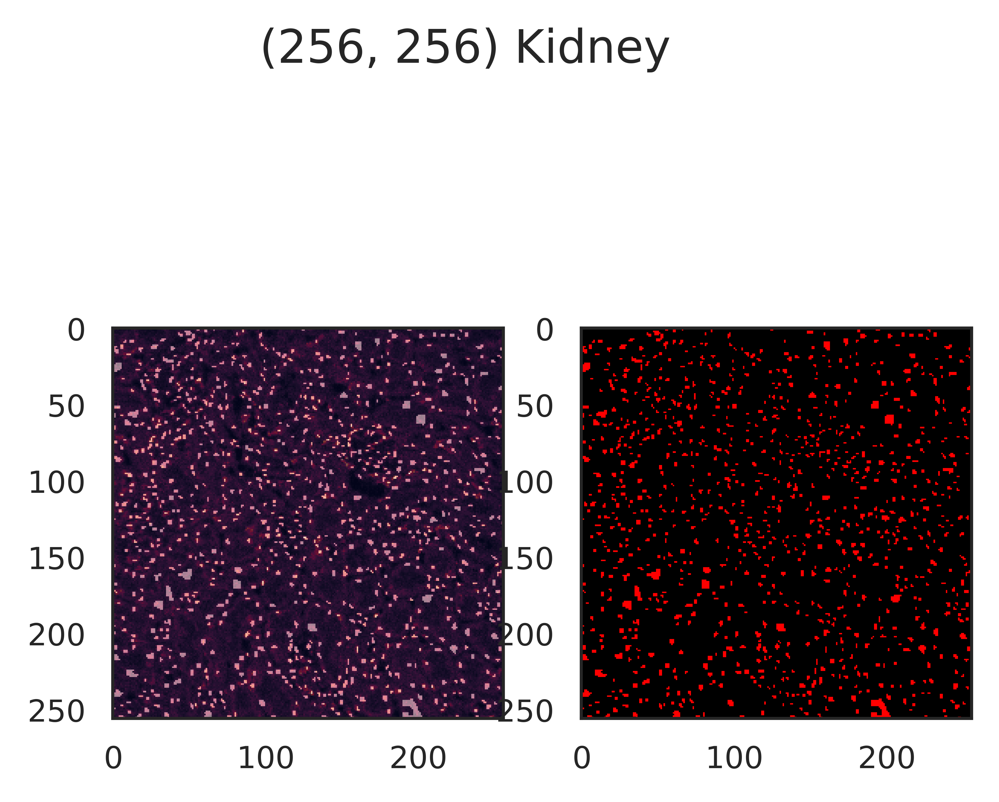

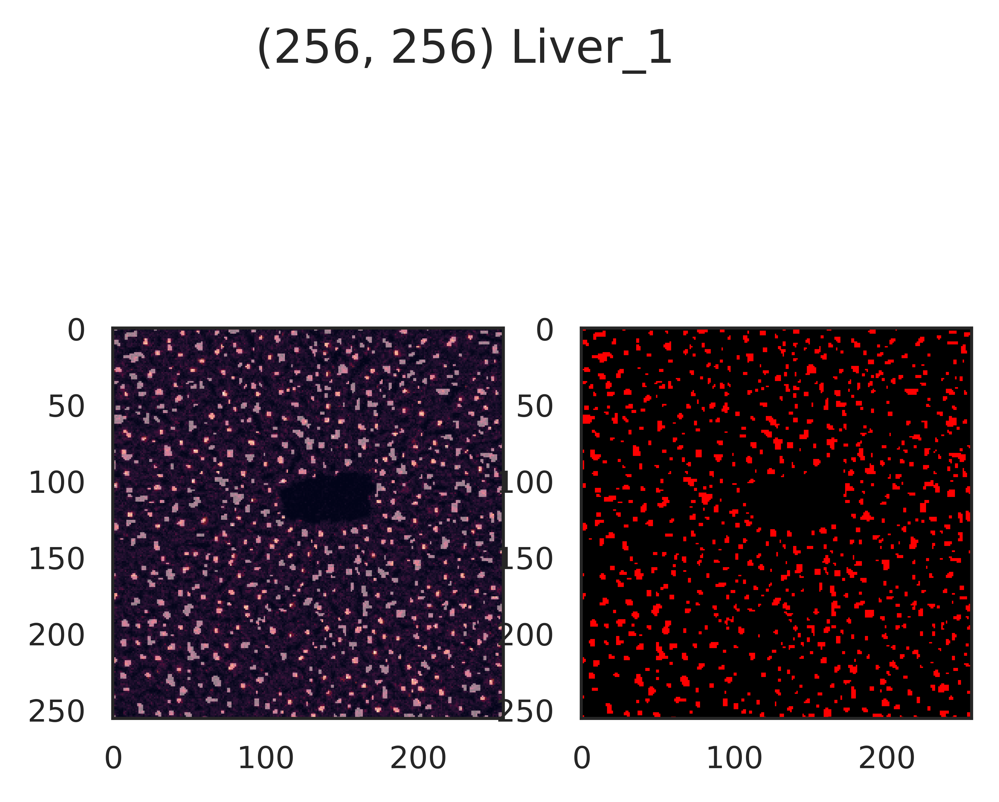

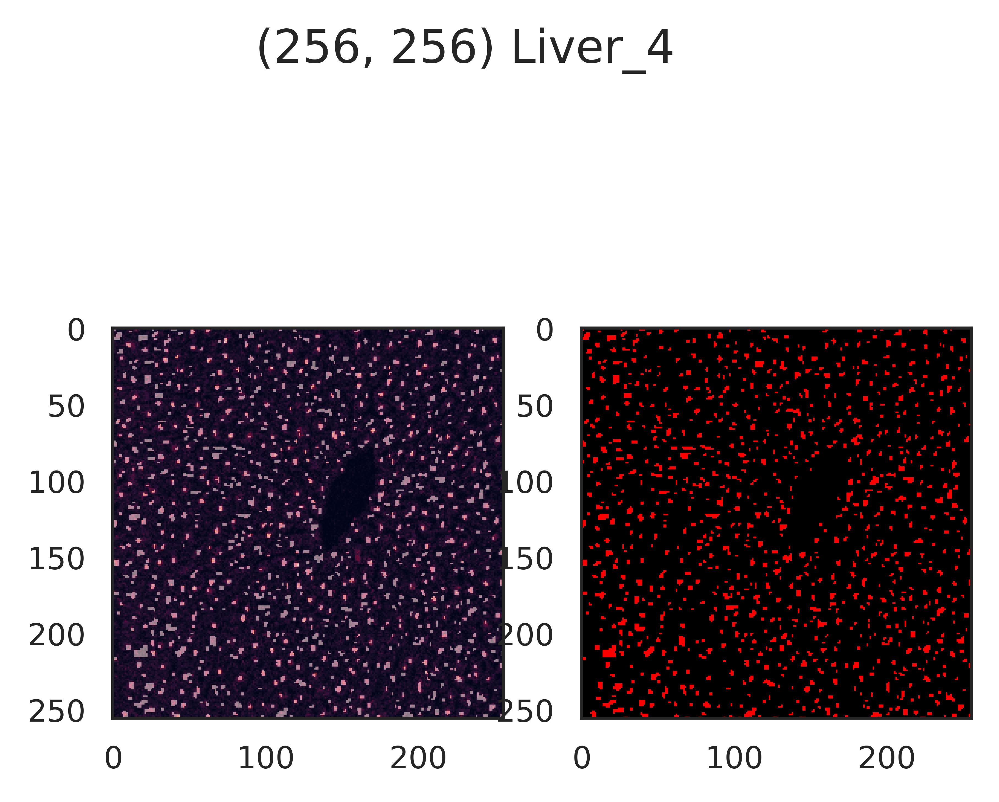

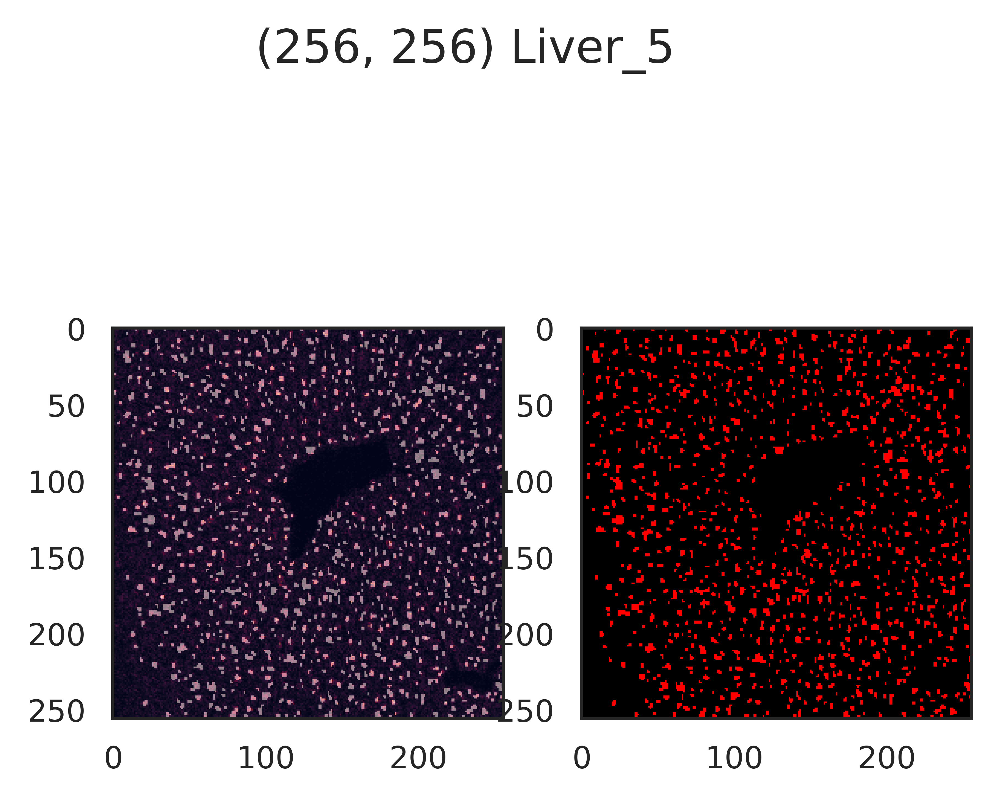

...

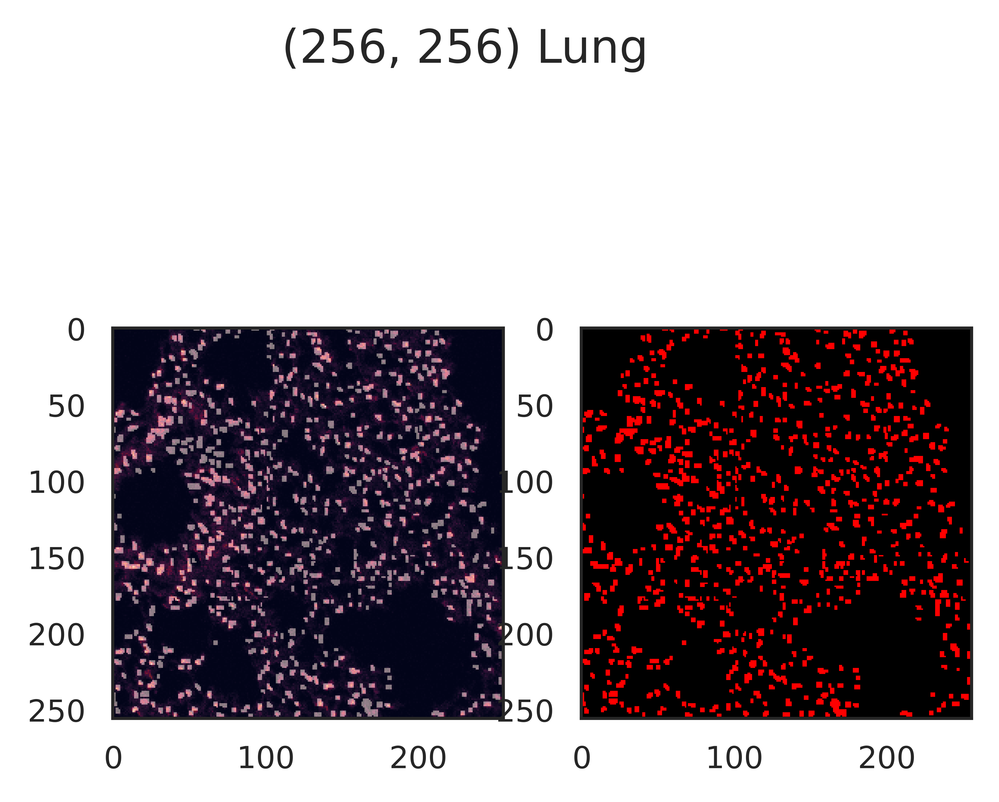

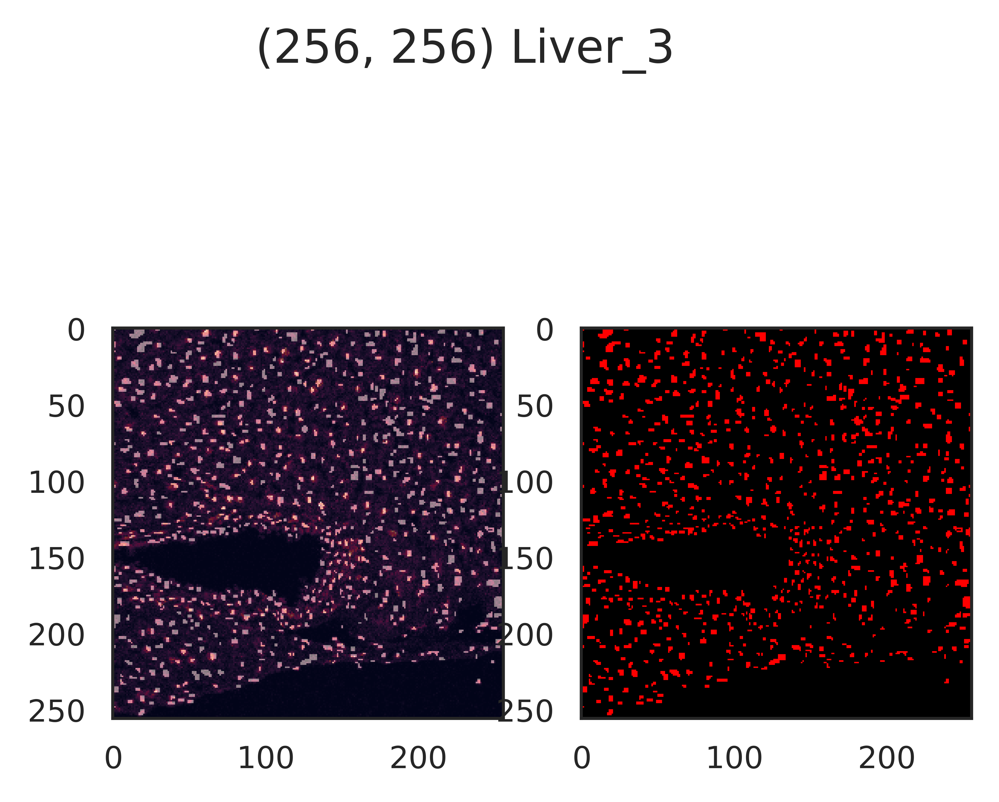

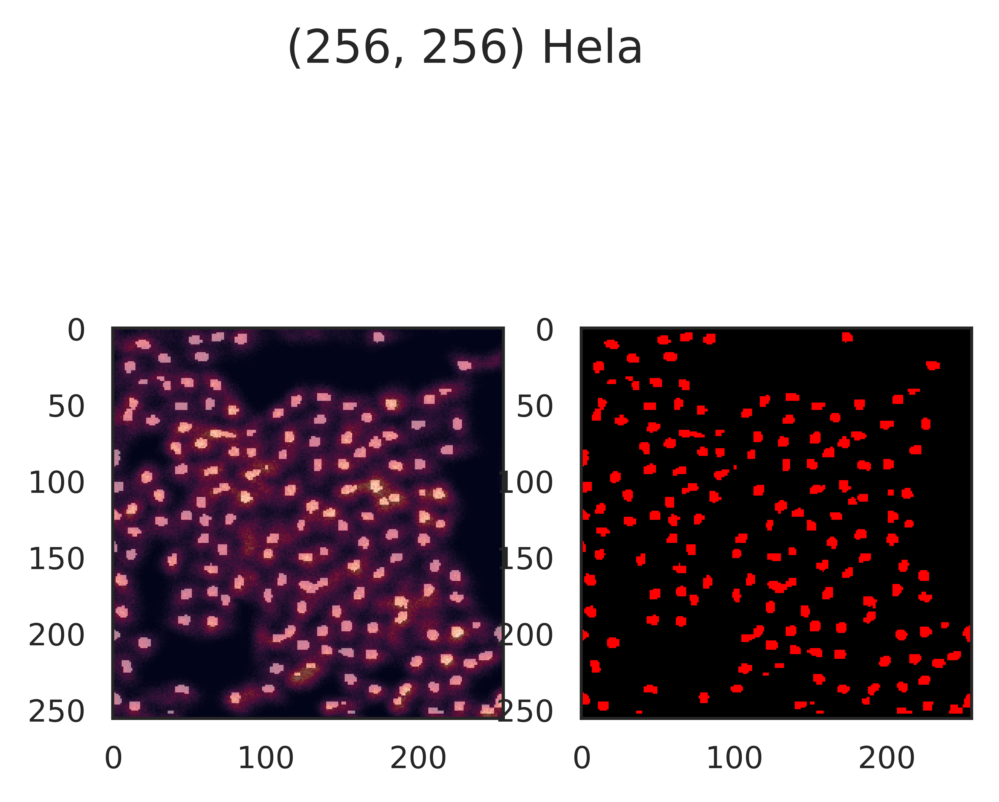

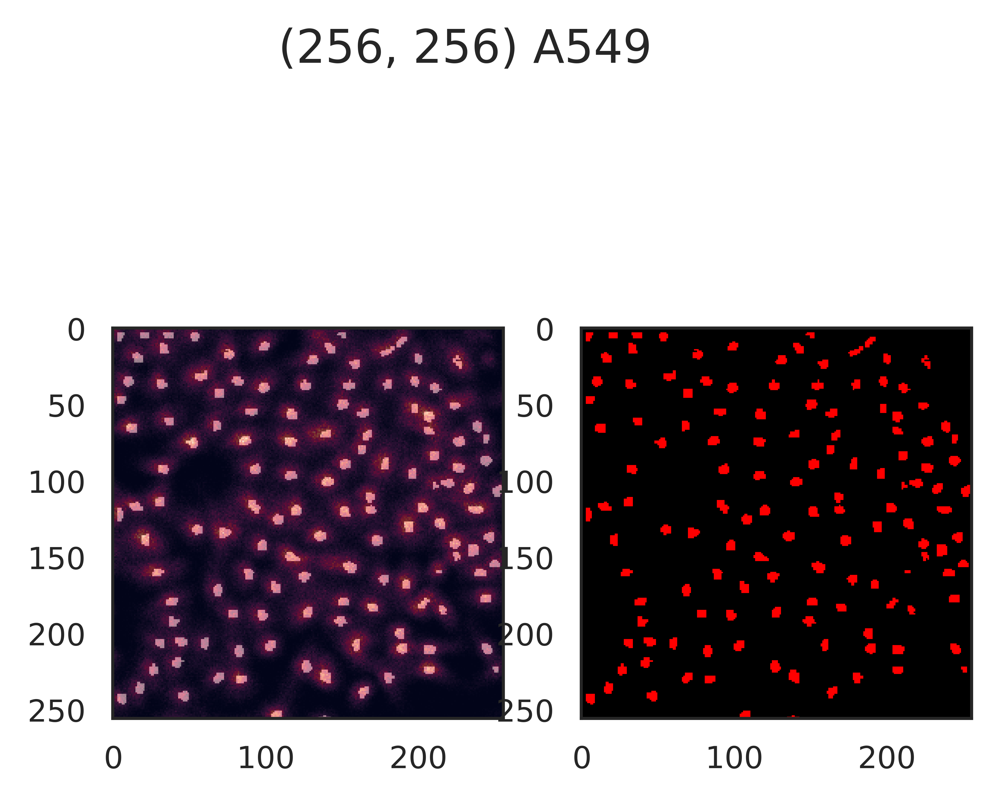

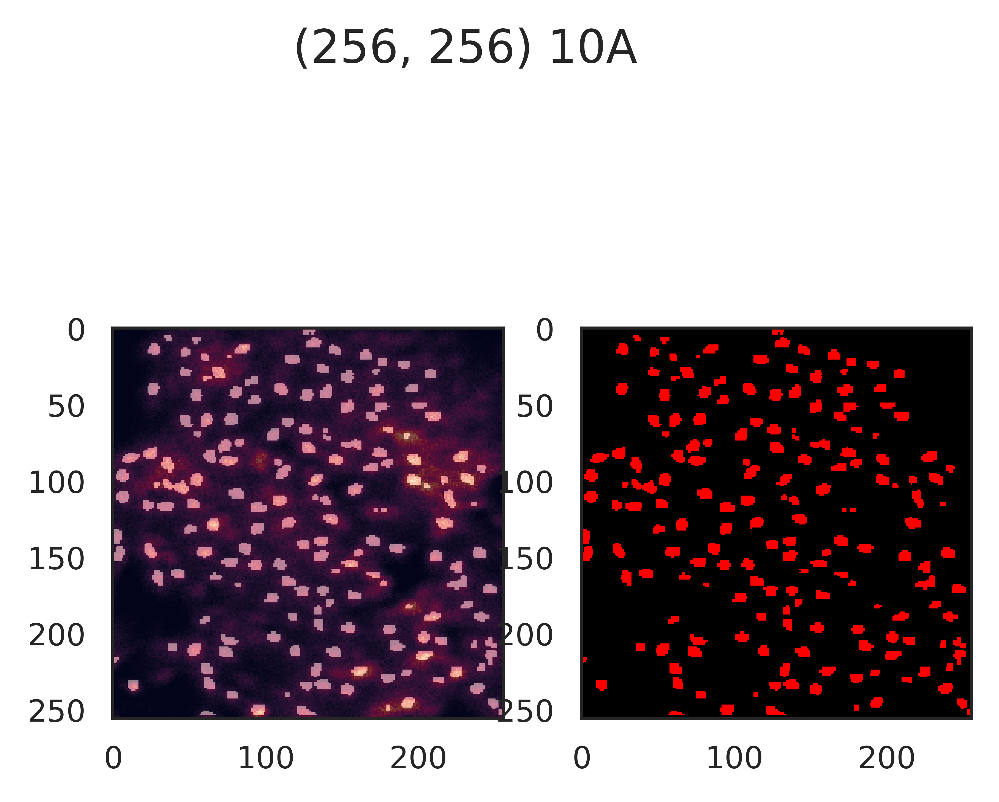

In [372]:
for key in sample_mask_dict_all.keys():
    SIMS_256 = tissue_adenine_dict[key]
    Cut_256 = sample_mask_dict_all[key]
    fig, axes = plt.subplots(1, 2)
    axes[0].imshow(SIMS_256)
    axes[0].imshow(Cut_256, alpha=0.5)
    axes[1].imshow(color.label2rgb(Cut_256, bg_label=0))
    fig.suptitle("{1} {0}".format(key, str(Cut_256.shape)))



### dump


In [376]:
with open("/home/yzy/bioSIMS/data/Segment_Cut/Cut_256.pickle", "wb") as handle:
    pickle.dump(sample_mask_dict_all, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open("/home/yzy/bioSIMS/data/Segment_SIMS/SIMS_256.pickle", "wb") as handle:
    pickle.dump(tissue_adenine_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [382]:
for key in sample_mask_dict_all.keys():
    print("{0} {1} {2}".format(key, str(sample_mask_dict_all[key].shape), str(tissue_adenine_dict[key].shape)))



Intestine (256, 256) (256, 256)
Kidney (256, 256) (256, 256)
Liver_1 (256, 256) (256, 256)
Liver_4 (256, 256) (256, 256)
Liver_5 (256, 256) (256, 256)
Liver_6 (256, 256) (256, 256)
R6 (256, 256) (256, 256)
R7 (256, 256) (256, 256)
R8 (256, 256) (256, 256)
R9 (256, 256) (256, 256)
R10 (256, 256) (256, 256)
R5 (256, 256) (256, 256)
R2 (256, 256) (256, 256)
R1 (256, 256) (256, 256)
R4 (256, 256) (256, 256)
R3 (256, 256) (256, 256)
Liver_2 (256, 256) (256, 256)
SK (256, 256) (256, 256)
MCF7 (256, 256) (256, 256)
Lung (256, 256) (256, 256)
Liver_3 (256, 256) (256, 256)
Hela (256, 256) (256, 256)
A549 (256, 256) (256, 256)
10A (256, 256) (256, 256)


In [381]:
sample_mask_dict_all[key].shape


(256, 256)